<a href="https://colab.research.google.com/github/awagler2/SDG-metrics/blob/main/Metrics_for_Adult_CTGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Include necessary libraries

# Forest Plot

<p><strong>Import Libraries</strong></p>

<p><strong>Load and Preprocess Data:</strong> Real and synthetic datasets are loaded from CSV files, and the 'Unnamed: 0' column is removed.</p>

<p><strong>Correlation Analysis:</strong> Correlations between 'education' and 'education-num' are computed.</p>

<p><strong>Data Transformation:</strong> Post correlation analysis, 'education' is dropped. The remaining categorical features are one-hot encoded to convert them into a format suitable for modeling.</p>

<p><strong>Data Summary:</strong> A summary of the transformed datasets is printed, showing the shape and columns, ensuring successful transformations.</p>

<p><strong>Prepare Data for Regression Analysis:</strong> Features and target variable are separated, features are converted to integers, and a constant term is added to include the intercept in the regression model.</p>

<p><strong>Fit Ordinary Least Squares (OLS) Regression Models:</strong> OLS models are fitted to both datasets. Parameters and confidence intervals are extracted to compare feature impacts between datasets.</p>

<p><strong>Output Data Types:</strong> The final part of the script verifies that all data transformations were correctly applied by printing the data types of features.</p>

In [ ]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split

real_data_for = pd.read_csv('real_adults.csv')
syn_data_for = pd.read_csv('syn_adults_0.csv')

# remove the 'Unnamed: 0' column
real_data_for.drop('Unnamed: 0', axis=1, inplace=True)
syn_data_for.drop('Unnamed: 0', axis=1, inplace=True)

# calculate correlations before dropping 'education'
correlation_syn = syn_data_for[['education', 'education-num']].corr()
correlation_real = real_data_for[['education', 'education-num']].corr()

correlation_results = {
    "Synthetic Data Correlation": correlation_syn,
    "Real Data Correlation": correlation_real
}

print(correlation_results)

# we drop 'education'
real_data_for.drop('education', axis=1, inplace=True)
syn_data_for.drop('education', axis=1, inplace=True)

# defining categorical features for one-hot encoding
categorical_features = [
    'marital-status', 'occupation', 'relationship', 'race', 'sex',
    'native-country', 'employment_type']

real_data_encoded = pd.get_dummies(real_data_for, columns=categorical_features)
syn_data_encoded = pd.get_dummies(syn_data_for, columns=categorical_features)

transformed_summary = {
    "Synthetic Data": {"Shape": syn_data_encoded.shape, "Columns": syn_data_encoded.columns},
    "Real Data": {"Shape": real_data_encoded.shape, "Columns": real_data_encoded.columns}
}

print(transformed_summary)

y_real = real_data_encoded['income']
X_real = real_data_encoded.drop('income', axis=1)
y_syn = syn_data_encoded['income']
X_syn = syn_data_encoded.drop('income', axis=1)

# convert feature data to integer
X_real = X_real.astype(int)
X_syn = X_syn.astype(int)

# add a constant to the predictors
X_real_const = sm.add_constant(X_real)
X_syn_const = sm.add_constant(X_syn)

# Fit the OLS models and handle exceptions
try:
    model_real = sm.OLS(y_real, X_real_const).fit()
    model_syn = sm.OLS(y_syn, X_syn_const).fit()

    slopes_real = model_real.params
    ci_real = model_real.conf_int()
    slopes_syn = model_syn.params
    ci_syn = model_syn.conf_int()

    print("Model fitting worked now.")
except Exception as e:
    print(f"Error: {e}")

print("Real Data Types:\n", X_real.dtypes.value_counts())
print("\nSynthetic Data Types:\n", X_syn.dtypes.value_counts())

print("Real Data Model Slopes and Confidence Intervals:\n", slopes_real)
print(ci_real)

print("\nSynthetic Data Model Slopes and Confidence Intervals:\n", slopes_syn)
print(ci_syn)

{'Synthetic Data Correlation':                education  education-num
education       1.000000       0.848143
education-num   0.848143       1.000000, 'Real Data Correlation':                education  education-num
education       1.000000       0.991147
education-num   0.991147       1.000000}
{'Synthetic Data': {'Shape': (30162, 40), 'Columns': Index(['age', 'education-num', 'capital-gain', 'capital-loss',
       'hours-per-week', 'income', 'marital-status_0', 'marital-status_1',
       'occupation_1', 'occupation_2', 'occupation_3', 'occupation_4',
       'occupation_5', 'occupation_6', 'occupation_8', 'occupation_9',
       'occupation_10', 'occupation_11', 'occupation_12', 'occupation_13',
       'occupation_14', 'relationship_0', 'relationship_1', 'relationship_2',
       'relationship_3', 'relationship_4', 'relationship_5', 'race_0',
       'race_1', 'race_2', 'race_3', 'race_4', 'sex_0', 'sex_1',
       'native-country_0', 'native-country_1', 'employment_type_0',
       'empl

<p><strong>Extract Coefficients and Confidence Intervals:</strong> Extract regression coefficients and their 95% confidence intervals from both the real and synthetic data models.</p>

<p><strong>Define Function for Interval Metrics:</strong> A function <code>interval_metrics</code> is defined to calculate several metrics based on the confidence intervals of coefficients. These include the length of each interval, the overlap between intervals, the distance between the centroids of intervals, and the percentage overlap relative to the total span of both intervals.</p>

<p><strong>Calculate and Print Intervals and Overlaps:</strong> For each feature present in both models, the function calculates and prints the interval metrics. This includes:
<ul>
  <li>Length of the 95% confidence interval for each dataset,</li>
  <li>Distance between the centroids of the intervals,</li>
  <li>Area of overlap between the intervals, and</li>
  <li>Percentage of the overlap relative to the total interval span.</li>
</ul></p>

In [ ]:
coefficients_real = model_real.params
conf_int_real = model_real.conf_int()
coefficients_syn = model_syn.params
conf_int_syn = model_syn.conf_int()

def interval_metrics(a, b):
    length_a = a[1] - a[0]
    length_b = b[1] - b[0]
    overlap = max(0, min(a[1], b[1]) - max(a[0], b[0]))
    distance_centroids = np.abs((a[1] + a[0])/2 - (b[1] + b[0])/2)
    total_interval = max(a[1], b[1]) - min(a[0], b[0])
    overlap_percent = (overlap / total_interval) * 100 if total_interval > 0 else 0
    return length_a, length_b, distance_centroids, overlap, overlap_percent

for feature in coefficients_real.index:
    if feature in coefficients_syn.index:
        real_interval = (conf_int_real.loc[feature, 0], conf_int_real.loc[feature, 1])
        syn_interval = (conf_int_syn.loc[feature, 0], conf_int_syn.loc[feature, 1])
        length_real, length_syn, dist_centroids, overlap_area, overlap_percent = interval_metrics(real_interval, syn_interval)

        print(f"Feature: {feature}")
        print(f"Length of Interval of 95% CI for Real Data: {length_real:.2f}")
        print(f"Length of Interval of 95% CI for Synthetic Data: {length_syn:.2f}")
        print(f"Distance between centroids: {dist_centroids:.2f}")
        print(f"Overlap area: {overlap_area:.2f}")
        print(f"Overlap percentage: {overlap_percent:.2f}%")
        print("---------------------------------------------------")

Feature: const
Length of Interval of 95% CI for Real Data: 0.04
Length of Interval of 95% CI for Synthetic Data: 0.02
Distance between centroids: 0.06
Overlap area: 0.00
Overlap percentage: 0.00%
---------------------------------------------------
Feature: age
Length of Interval of 95% CI for Real Data: 0.00
Length of Interval of 95% CI for Synthetic Data: 0.00
Distance between centroids: 0.00
Overlap area: 0.00
Overlap percentage: 0.00%
---------------------------------------------------
Feature: education-num
Length of Interval of 95% CI for Real Data: 0.00
Length of Interval of 95% CI for Synthetic Data: 0.00
Distance between centroids: 0.01
Overlap area: 0.00
Overlap percentage: 0.00%
---------------------------------------------------
Feature: capital-gain
Length of Interval of 95% CI for Real Data: 0.03
Length of Interval of 95% CI for Synthetic Data: 0.02
Distance between centroids: 0.00
Overlap area: 0.02
Overlap percentage: 67.98%
----------------------------------------------

<p><strong>Extract Coefficients and Confidence Intervals:</strong> Again, Extract regression coefficients and their respective 95% confidence intervals for both the real and synthetic data models. </p>

<p><strong>Filter Common Features:</strong> Identifies features common to both datasets.</p>

<p><strong>Prepare Data for Forest Plot:</strong> Organize data for plotting by collecting coefficients and their confidence intervals for the common features from both datasets.</p>

<p><strong>Create and Customize the Plot:</strong> A forest plot is created to  compare the coefficients and confidence intervals:
<ul>
  <li><strong>Error Bars Calculation:</strong> Calculates the upper and lower errors for the coefficients from their confidence intervals for both datasets.</li>
  <li><strong>Plotting Error Bars:</strong> Plots these error bars for each feature, with real data in blue and synthetic data in red.</li>
  <li><strong>Plot Customization:</strong> Customizes the plot by setting feature labels, inverting the y-axis so the first feature appears at the top, adding a vertical line at zero for reference, and including grid lines for better readability.</li>
</ul>

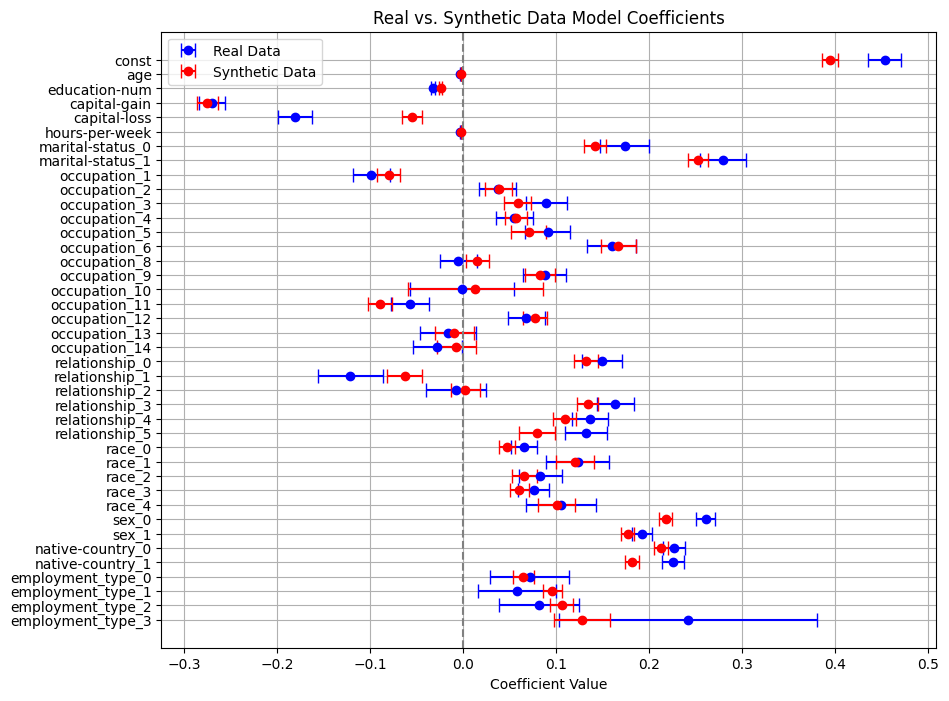

In [ ]:
coefficients_real = model_real.params
conf_int_real = model_real.conf_int()
coefficients_syn = model_syn.params
conf_int_syn = model_syn.conf_int()

# include only common features
common_features = coefficients_real.index.intersection(coefficients_syn.index)

# data for forest plot using only common features
data = {
    "Feature": common_features,
    "Real Coefficients": coefficients_real[common_features],
    "Real CI Lower": conf_int_real.loc[common_features, 0],
    "Real CI Upper": conf_int_real.loc[common_features, 1],
    "Synthetic Coefficients": coefficients_syn[common_features],
    "Synthetic CI Lower": conf_int_syn.loc[common_features, 0],
    "Synthetic CI Upper": conf_int_syn.loc[common_features, 1]
}

fig, ax = plt.subplots(figsize=(10, 8))
features = range(len(data["Feature"]))
tick_labels = data["Feature"]

# calculate the error bars
real_errors = [[data["Real Coefficients"][i] - data["Real CI Lower"][i], data["Real CI Upper"][i] - data["Real Coefficients"][i]] for i in features]
syn_errors = [[data["Synthetic Coefficients"][i] - data["Synthetic CI Lower"][i], data["Synthetic CI Upper"][i] - data["Synthetic Coefficients"][i]] for i in features]

ax.errorbar(data["Real Coefficients"], features, xerr=np.transpose(real_errors), fmt='o', label='Real Data', color='blue', capsize=5)
ax.errorbar(data["Synthetic Coefficients"], features, xerr=np.transpose(syn_errors), fmt='o', label='Synthetic Data', color='red', capsize=5)

ax.set_yticks(features)
ax.set_yticklabels(tick_labels)
ax.invert_yaxis()
ax.axvline(x=0, color='grey', linestyle='--')
ax.set_xlabel('Coefficient Value')
ax.set_title('Real vs. Synthetic Data Model Coefficients')
ax.legend()
ax.grid(True)

plt.show()

<p><strong>Data Loading and Preprocessing:</strong> The script starts by loading the real dataset and multiple synthetic datasets from CSV files. Unwanted columns ('Unnamed: 0') are removed from each dataset to clean the data. All datasets are combined temporarily to ensure consistent feature encoding.</p>

<p><strong>One-hot Encoding:</strong> Categorical features are identified and one-hot encoded across the combined dataset. This step is crucial as it transforms categorical variables into a format suitable for regression analysis by creating binary dummy variables.</p>

<p><strong>Splitting Datasets:</strong> After encoding, the combined dataset is split back into the individual real and synthetic datasets. This separation is necessary to fit separate models for each dataset.</p>

<p><strong>Model Fitting for Real Data:</strong> An Ordinary Least Squares (OLS) regression model is fitted to the real dataset. The model coefficients are then stored for comparison with the synthetic datasets.</p>

<p><strong>Model Fitting for Synthetic Data:</strong> Similar to the real data, OLS models are fitted to each synthetic dataset. Coefficients from these models are collected separately.</p>

<p><strong>Boxplot Data Preparation:</strong> A dictionary is constructed to hold coefficients from the real and each synthetic dataset, which is then converted into a DataFrame. This DataFrame organizes the coefficients in a way that facilitates their comparison across datasets using boxplots.</p>

<p><strong>Boxplot Visualization:</strong> Boxplots are generated to visually compare the distribution of coefficients across all datasets. This includes:
<ul>
  <li>Displaying the spread and central tendency of coefficients for each dataset,</li>
  <li>Highlighting differences and similarities in the effects estimated by the models,</li>
  <li>Improving readability by rotating x-axis labels and adding grid lines.</li>
</ul>
This visualization helps in assessing the consistency and variability of synthetic data relative to the real data, offering insights into the synthetic data generation process.</p>

<p>The boxplots provide a comprehensive visual summary that is invaluable for understanding how closely synthetic datasets mimic the real dataset in terms of their statistical properties.</p>

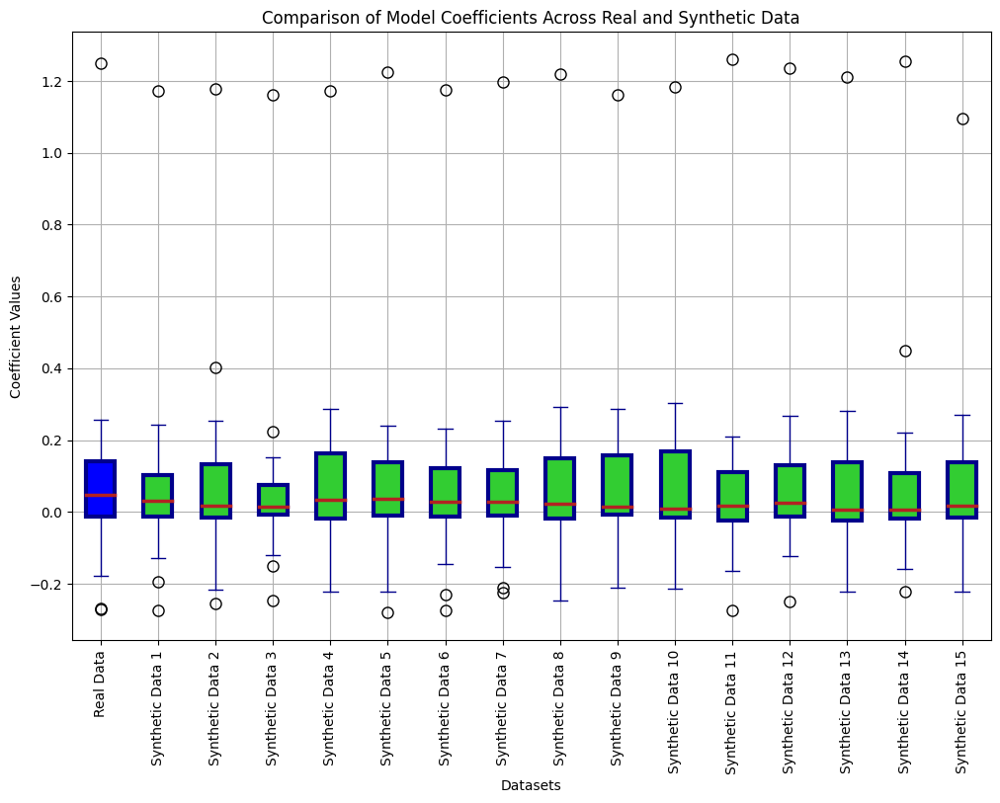

In [ ]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
import matplotlib.pyplot as plt

real_data = pd.read_csv('real_adults.csv')
real_data.drop('Unnamed: 0', axis=1, inplace=True)

list_of_synthetic_datasets = [pd.read_csv(f'syn_adults_{i}.csv') for i in range(15)]
for dataset in list_of_synthetic_datasets:
    dataset.drop('Unnamed: 0', axis=1, inplace=True)

categorical_features = [
    'marital-status', 'occupation', 'relationship', 'race', 'sex',
    'native-country', 'employment_type']

# here we combine all datasets for uniform feature columns after one-hot encoding
combined = pd.concat([real_data] + list_of_synthetic_datasets, ignore_index=True)
combined_encoded = pd.get_dummies(combined, columns=categorical_features, drop_first=True)

# Split the combined encoded dataset back into real and synthetic datasets
real_data_encoded = combined_encoded.iloc[:len(real_data)]
list_of_encoded_synthetic_datasets = [combined_encoded.iloc[len(real_data) + i * len(dataset):len(real_data) + (i + 1) * len(dataset)] for i, dataset in enumerate(list_of_synthetic_datasets)]

# fit
y_real = real_data_encoded['income']
X_real = real_data_encoded.drop('income', axis=1).astype(float)
X_real_const = sm.add_constant(X_real)
model_real = sm.OLS(y_real, X_real_const).fit()

coefficients_data = {'Real Data': model_real.params.values}

for idx, syn_data_encoded in enumerate(list_of_encoded_synthetic_datasets):
    y_syn = syn_data_encoded['income']
    X_syn = syn_data_encoded.drop('income', axis=1).astype(float)
    X_syn_const = sm.add_constant(X_syn)
    model_syn = sm.OLS(y_syn, X_syn_const).fit()
    coefficients_data[f'Synthetic Data {idx+1}'] = model_syn.params.values

coefficients_df = pd.DataFrame(coefficients_data)

colors = ['blue'] + ['limegreen' for i in range(15)]

plt.figure(figsize=(12, 8))
boxprops = dict(linestyle='-', linewidth=3, color='darkblue')  # set default color for boxes
medianprops = dict(linestyle='-', linewidth=2.5, color='firebrick')

bp = coefficients_df.boxplot(boxprops=boxprops, medianprops=medianprops, patch_artist=True,
                             capprops=dict(color='darkblue'), whiskerprops=dict(color='darkblue'),
                             flierprops=dict(marker='o', color='grey', markersize=8),
                             return_type='dict')

for box, color in zip(bp['boxes'], colors):
    box.set_facecolor(color)

plt.title('Comparison of Model Coefficients Across Real and Synthetic Data')
plt.xlabel('Datasets')
plt.ylabel('Coefficient Values')
plt.xticks(rotation=90)
plt.grid(True)
plt.show()



<p><strong>Import Libraries:</strong> Essential Python data visualization libraries like matplotlib and seaborn, along with pandas for data handling, are imported.</p>
<p><strong>Define Features:</strong> A list of features for visualization is created. This list can be customized to include more or fewer features depending on the analysis needs.</p>
<p><strong>Setup Plotting Area:</strong> A plotting area is configured using matplotlib's subplots, creating a grid of plots to accommodate multiple density plots.</p>
<p><strong>Density Plotting for Real Data:</strong> For each specified feature, a density plot is generated for the real dataset using seaborn’s kdeplot. Each plot is labeled and styled to distinguish easily between features and datasets.</p>
<p><strong>Density Plotting for Synthetic Data:</strong> Similarly, for each feature, density plots are generated for multiple synthetic datasets. These plots are overlaid on the same axes as the real data plots but distinguished by a different color and transparency, allowing visual comparison of distribution shapes.</p>
<p><strong>Layout Adjustment:</strong> The layout is adjusted to prevent plot overlap and ensure clarity, providing a clean and organized visual output.</p>
<p><strong>Show Plot:</strong> Finally, the complete set of plots is displayed using plt.show(). This visualization facilitates a comparative analysis between real and synthetic data distributions across selected features.</p>

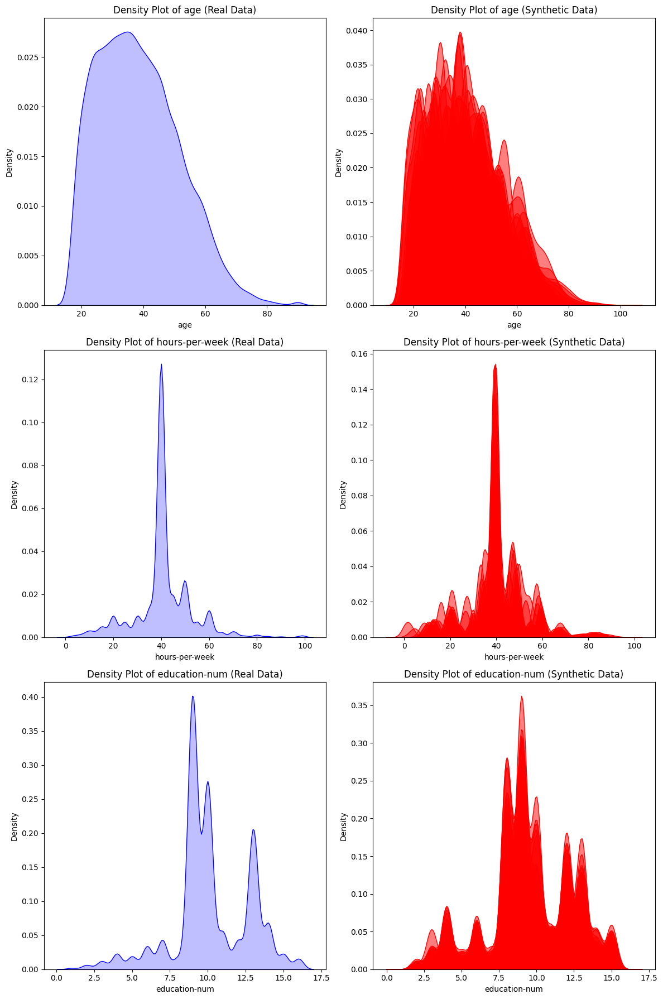

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# List of features to plot. We can change these to see more or less features as well as change the features we want to see
features = ['age', 'hours-per-week', 'education-num']

fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(12, 18))

for index, feature in enumerate(features):
    sns.kdeplot(real_data_encoded[feature], ax=axes[index, 0], color='blue', fill=True)
    axes[index, 0].set_title('Density Plot of ' + feature + ' (Real Data)')
    axes[index, 0].set_xlabel(feature)
    axes[index, 0].set_ylabel('Density')

    for df in list_of_encoded_synthetic_datasets:
        sns.kdeplot(df[feature], ax=axes[index, 1], color='red', alpha=0.5, fill=True)
    axes[index, 1].set_title('Density Plot of ' + feature + ' (Synthetic Data)')
    axes[index, 1].set_xlabel(feature)
    axes[index, 1].set_ylabel('Density')

plt.tight_layout()
plt.show()


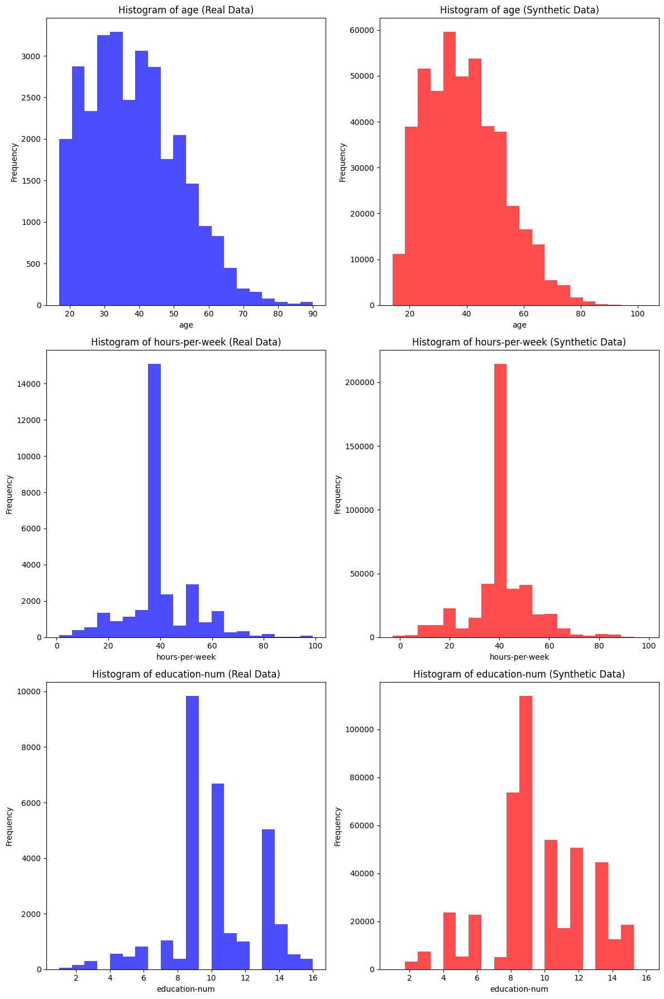

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

features = ['age', 'hours-per-week', 'education-num']

fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(12, 18))

for index, feature in enumerate(features):
    axes[index, 0].hist(real_data_encoded[feature], color='blue', alpha=0.7, bins=20)
    axes[index, 0].set_title('Histogram of ' + feature + ' (Real Data)')
    axes[index, 0].set_xlabel(feature)
    axes[index, 0].set_ylabel('Frequency')

    combined_synthetic = pd.concat([df[feature] for df in list_of_encoded_synthetic_datasets])
    axes[index, 1].hist(combined_synthetic, color='red', alpha=0.7, bins=20)
    axes[index, 1].set_title('Histogram of ' + feature + ' (Synthetic Data)')
    axes[index, 1].set_xlabel(feature)
    axes[index, 1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

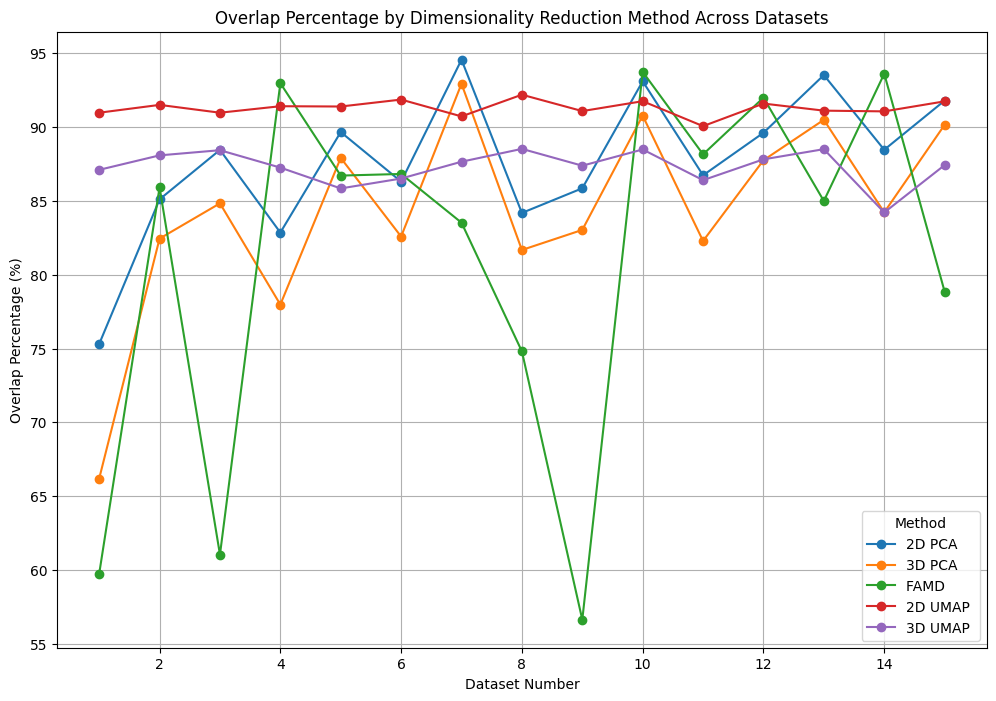

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

data = pd.read_csv('Tables Adult.csv')

data.head(), data.columns

plt.figure(figsize=(12, 8))

for method in data['Method'].unique():
    subset = data[data['Method'] == method]
    plt.plot(subset['Dataset'], subset['Overlap Percent'], label=method, marker='o')

plt.title('Overlap Percentage by Dimensionality Reduction Method Across Datasets')
plt.xlabel('Dataset Number')
plt.ylabel('Overlap Percentage (%)')
plt.legend(title='Method')
plt.grid(True)
plt.show()

<p><strong>Install Packages:</strong> Necessary Python packages are installed using pip, including 'prince' for factor analysis of mixed data and 'umap-learn' for advanced dimensionality reduction.</p>
<p><strong>Import Libraries:</strong> Libraries such as pandas, numpy, matplotlib, seaborn, and specific modules from sklearn, umap, and prince are imported for data manipulation, visualization, and analysis.</p>
<p><strong>Load Dataset:</strong> The real dataset is loaded into a DataFrame from a CSV file for processing.</p>
<p><strong>Load Synthetic Datasets:</strong> Multiple synthetic datasets are loaded using a list comprehension, reading from specified CSV files.</p>
<p><strong>Data Cleaning:</strong> A function is defined to clean data by removing unnecessary columns, which is then applied to the real dataset.</p>
<p><strong>Data Encoding:</strong> Another function encodes categorical features using one-hot encoding to make the dataset suitable for further analysis.</p>
<p><strong>Separate Target Variable:</strong> A function separates the target variable from the features, preparing the dataset for modeling.</p>
<p><strong>Custom Mathematical Functions:</strong> Two functions are defined for calculating geometrical properties: one to calculate the area of overlap between two circles and another for the volume of intersection between two spheres.</p>
To determine the overlap between distributions, we use some geometric calculations for areas and volumes of intersection. For circles (in 2D visualizations), the area of overlap $A$ is calculated using the formula derived from the sector of a circle and triangle area calculations, applicable under the condition that the circles intersect:
$$
\begin{aligned}
& A=r_1^2 \cos ^{-1}\left(\frac{d^2+r_1^2-r_2^2}{2 d r_1}\right)+r_2^2 \cos ^{-1}\left(\frac{d^2+r_2^2-r_1^2}{2 d r_2}\right)- \\
& \frac{1}{2} \sqrt{\left(-d+r_1+r_2\right)\left(d+r_1-r_2\right)\left(d-r_1+r_2\right)\left(d+r_1+r_2\right)}
\end{aligned}
$$

If the circles do not intersect, the overlap area is zero. Conversely, if one circle is entirely within another, the overlap area is the area of the smaller circle.

For spheres (used in 3D visualizations), the volume of intersection $V$ is calculated as follows, valid only if $d<r_1+r_2:$
$$
V=\frac{\pi}{12 d}\left(r_1+r_2-d\right)^2\left(d^2+2 d\left(r_1+r_2\right)-3\left(r_1-r_2\right)^2\right)
$$

This formula implies that the spheres must overlap for the volume calculation to be valid. If $d \geq r_1+$ $r_2$, there is no intersection, and the volume is zero. If $d \leq\left|r_1-r_2\right|$, where one sphere completely encloses the other, the volume of intersection is that of the smaller sphere.
<p><strong>3D Visualization Helper Function:</strong> A utility function is included to help in drawing spheres in 3D space, which might be used in subsequent data visualization or geometric analyses.</p>
<p><strong>Install and Import Libraries:</strong> Essential Python packages and libraries are installed and imported to handle data manipulation, visualization, and dimensionality reduction techniques such as PCA, FAMD, and UMAP.</p>
<p><strong>Load and Prepare Data:</strong> Real and multiple synthetic datasets are loaded. Functions are defined to clean (remove unnecessary columns) and encode data (one-hot encode categorical features), and separate features from the target variable.</p>
<p><strong>Define Visualization and Geometry Functions:</strong> Custom functions are defined to calculate geometrical properties such as the overlap area between circles and the intersection volume between spheres. Additionally, utility functions for drawing spheres in 3D plots are provided.</p>
<p><strong>Principal Component Analysis (PCA):</strong> PCA is performed to reduce the dimensionality of the datasets to two and three dimensions, followed by visualizing the results. This involves calculating centroids, radii, and plotting the datasets with their respective centroids and radii indicated by circles or spheres for visual comparison.</p>
<p><strong>Factor Analysis of Mixed Data (FAMD):</strong> FAMD is executed to handle datasets with mixed data types. The procedure includes data preparation specific to FAMD, execution of the analysis, and visualization of the results with markers indicating significant data points and their centroids.</p>
<p><strong>Uniform Manifold Approximation and Projection (UMAP):</strong> UMAP is utilized for both two-dimensional and three-dimensional non-linear dimensionality reduction. It includes visualizations that highlight the centroids and calculated radii or volumes, providing insights into the similarity and overlap between real and synthetic data distributions.</p>
<p><strong>Iterative Analysis:</strong> Each synthetic dataset is processed iteratively to apply PCA, 3D PCA, FAMD, and UMAP visualizations. This structured approach allows for comprehensive analysis and comparison across multiple datasets, focusing on the consistency and accuracy of synthetic data generation methods compared to real data.</p>
<p><strong>Output Metrics:</strong> After each analysis step, relevant metrics such as areas, volumes, distances between centroids, and overlap percentages are calculated and displayed, providing quantitative insights into the relationships between the real and synthetic datasets.</p>

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


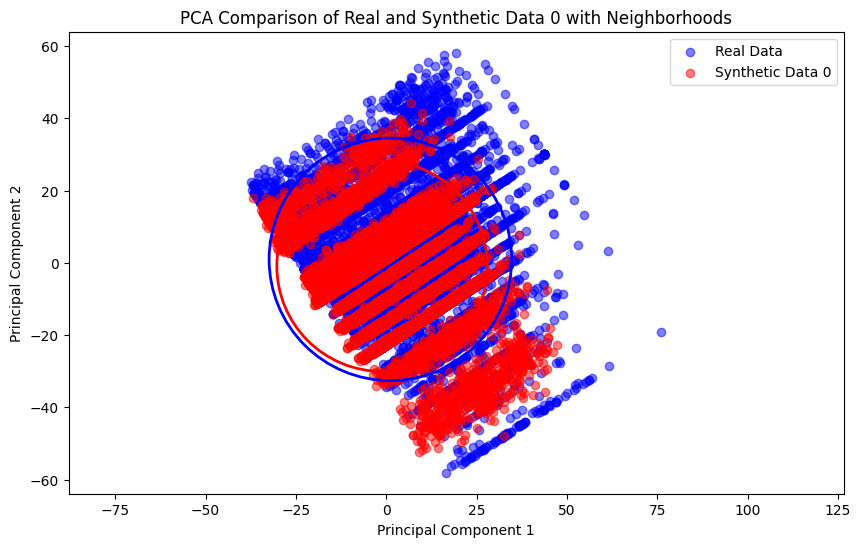

Dataset 0 - Area of 95% CI for Real Data: 3539.26
Dataset 0 - Area of 95% CI for Synthetic Data: 2665.54
Dataset 0 - Distance between centroids: 2.97
Dataset 0 - Overlap area: 2665.54
Dataset 0 - Overlap percentage: 75.31%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


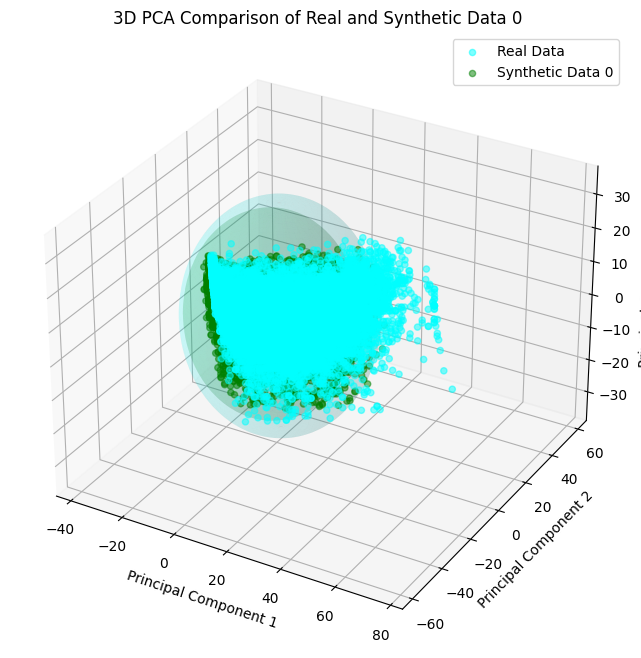

Dataset 0 - Volume of 95% CI for Real Data: 160260.80 cubic units
Dataset 0 - Volume of 95% CI for Synthetic Data: 106078.74 cubic units
Dataset 0 - Distance between centroids: 3.07 units
Dataset 0 - Overlap volume: 106078.74 cubic units
Dataset 0 - Overlap percentage: 66.19%


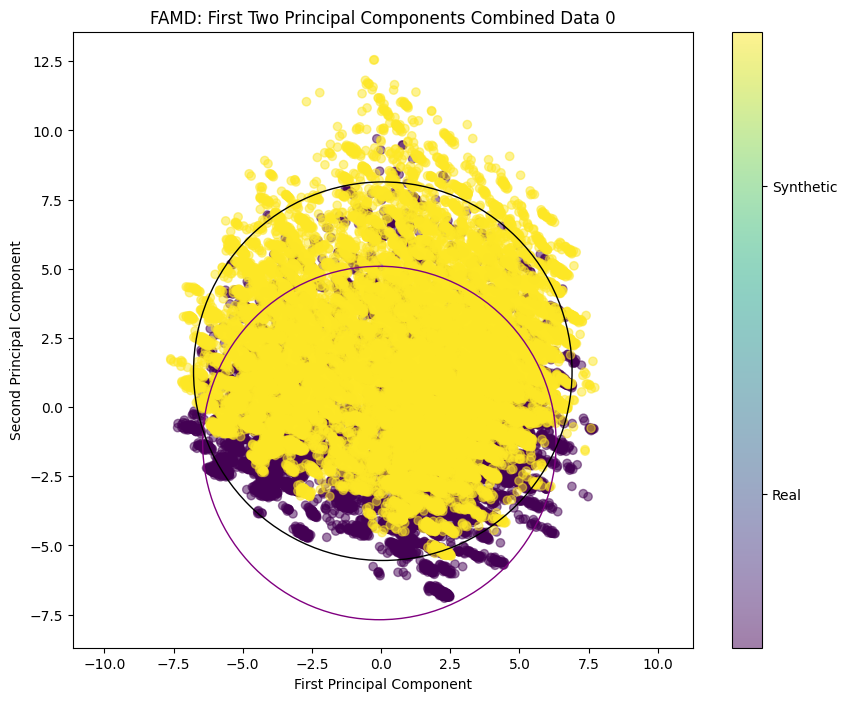

Dataset 0 - Area of 95% CI for Real Data: 128.19
Dataset 0 - Area of 95% CI for Synthetic Data: 147.03
Dataset 0 - Distance between centroids: 2.60
Dataset 0 - Overlap area: 102.93
Dataset 0 - Overlap percentage: 59.74%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


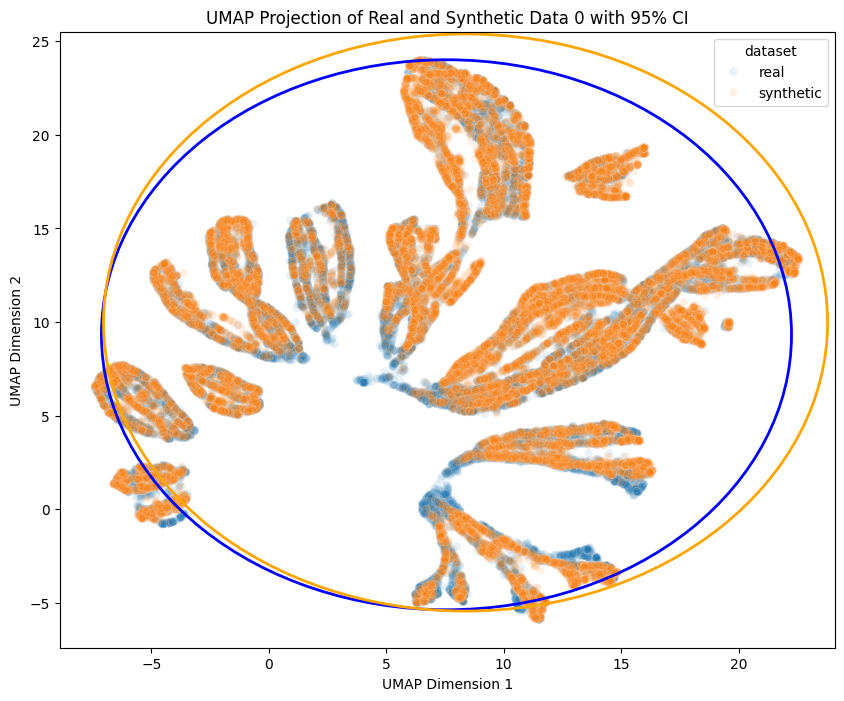

Dataset 0 - Area of 95% CI for Real Data: 677.58
Dataset 0 - Area of 95% CI for Synthetic Data: 745.99
Dataset 0 - Distance between centroids: 1.04
Dataset 0 - Overlap area: 672.51
Dataset 0 - Overlap percentage: 89.54%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


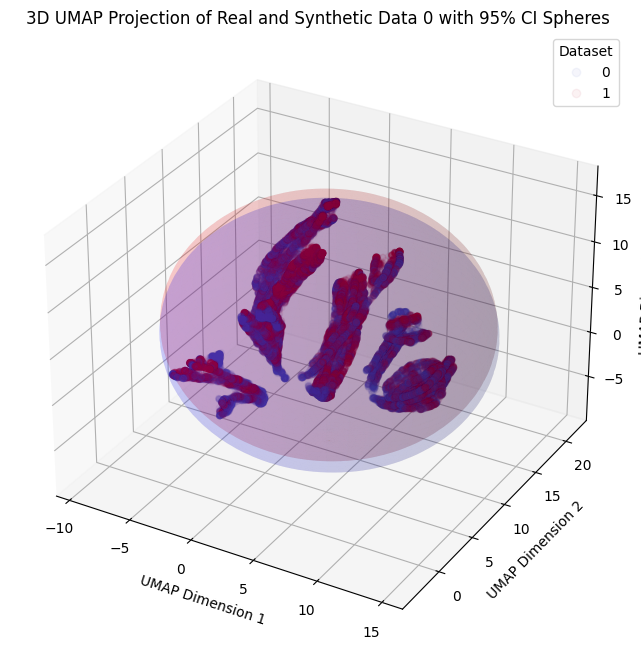

Dataset 0 - Volume of 95% CI for Real Data: 7205.97 cubic units
Dataset 0 - Volume of 95% CI for Synthetic Data: 7070.75 cubic units
Dataset 0 - Distance between centroids: 0.89 units
Dataset 0 - Overlap volume: 6736.33 cubic units
Dataset 0 - Overlap percentage: 89.34%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


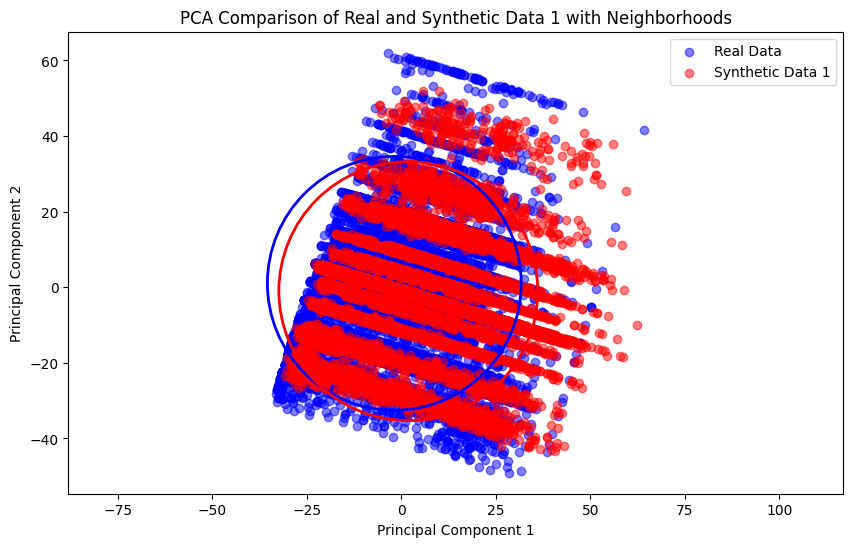

Dataset 1 - Area of 95% CI for Real Data: 3541.24
Dataset 1 - Area of 95% CI for Synthetic Data: 3683.33
Dataset 1 - Distance between centroids: 4.24
Dataset 1 - Overlap area: 3321.63
Dataset 1 - Overlap percentage: 85.11%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


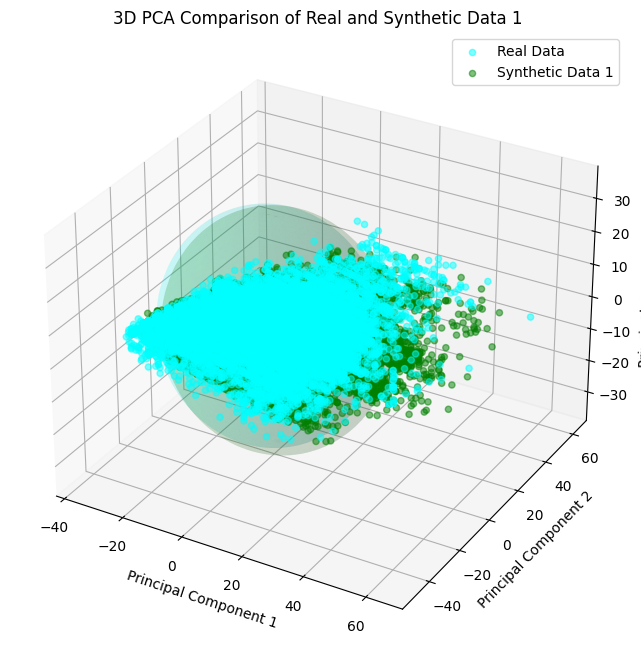

Dataset 1 - Volume of 95% CI for Real Data: 160262.79 cubic units
Dataset 1 - Volume of 95% CI for Synthetic Data: 170548.97 cubic units
Dataset 1 - Distance between centroids: 4.26 units
Dataset 1 - Overlap volume: 149491.56 cubic units
Dataset 1 - Overlap percentage: 82.45%


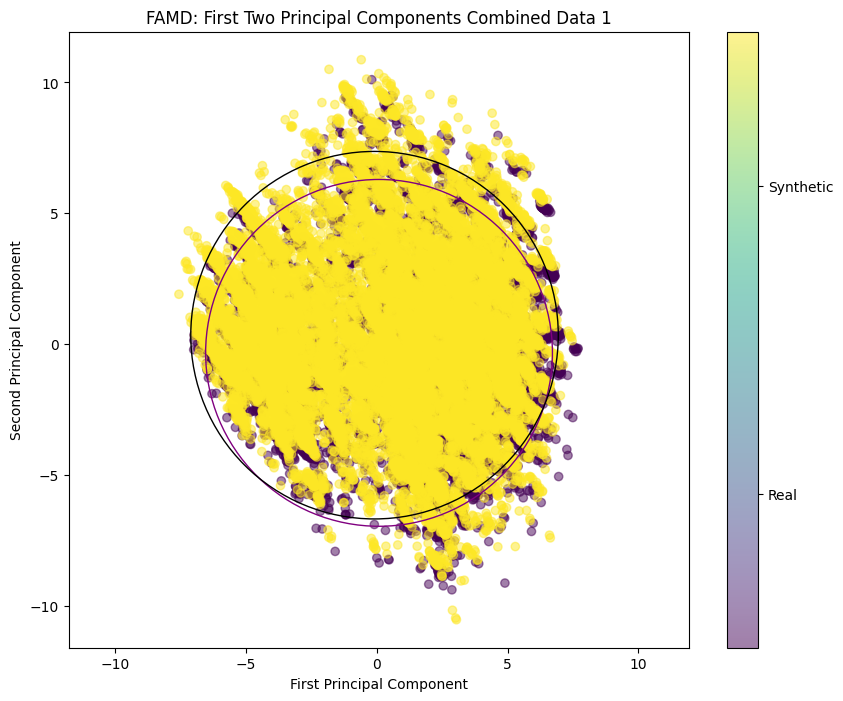

Dataset 1 - Area of 95% CI for Real Data: 138.04
Dataset 1 - Area of 95% CI for Synthetic Data: 155.01
Dataset 1 - Distance between centroids: 0.70
Dataset 1 - Overlap area: 135.43
Dataset 1 - Overlap percentage: 85.92%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


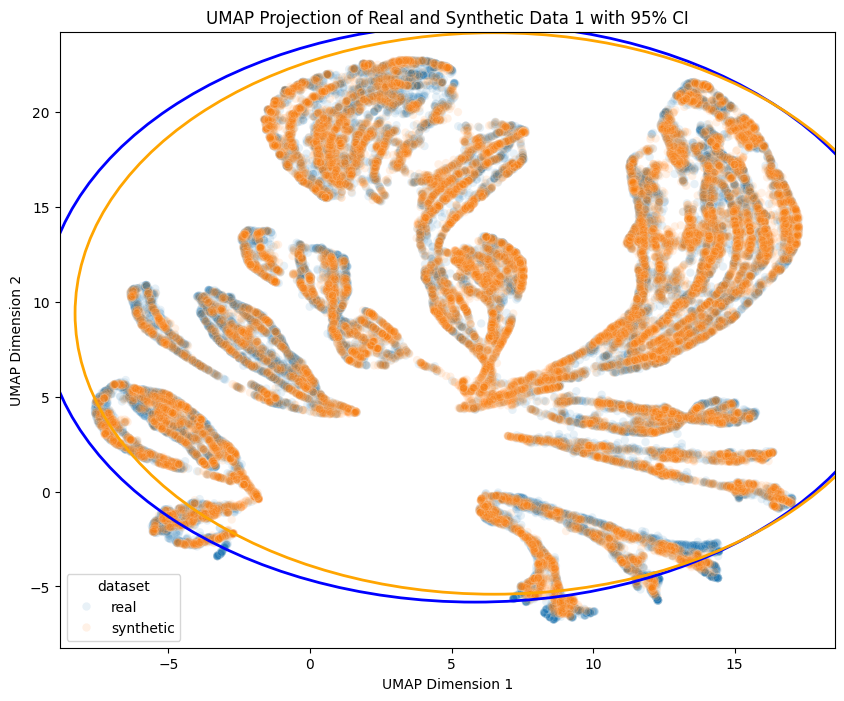

Dataset 1 - Area of 95% CI for Real Data: 730.69
Dataset 1 - Area of 95% CI for Synthetic Data: 688.64
Dataset 1 - Distance between centroids: 0.68
Dataset 1 - Overlap area: 684.64
Dataset 1 - Overlap percentage: 93.19%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


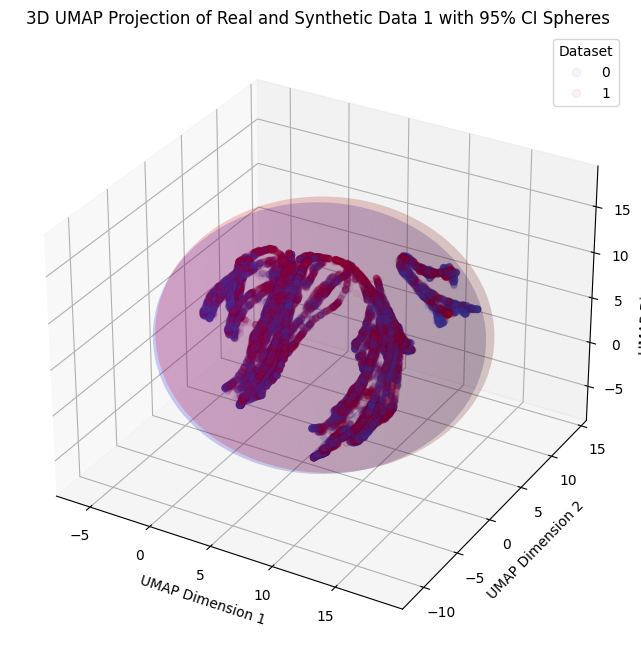

Dataset 1 - Volume of 95% CI for Real Data: 7053.04 cubic units
Dataset 1 - Volume of 95% CI for Synthetic Data: 7363.28 cubic units
Dataset 1 - Distance between centroids: 0.96 units
Dataset 1 - Overlap volume: 6763.14 cubic units
Dataset 1 - Overlap percentage: 88.37%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


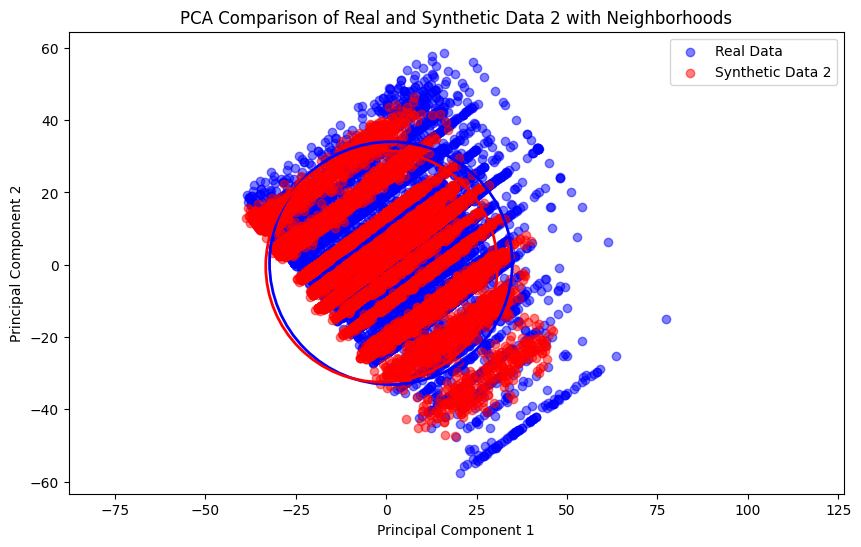

Dataset 2 - Area of 95% CI for Real Data: 3539.97
Dataset 2 - Area of 95% CI for Synthetic Data: 3224.81
Dataset 2 - Distance between centroids: 2.71
Dataset 2 - Overlap area: 3175.36
Dataset 2 - Overlap percentage: 88.46%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


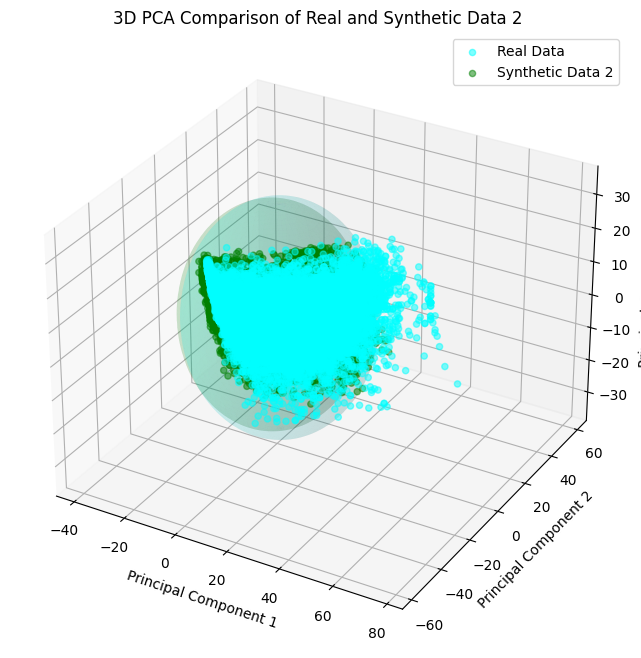

Dataset 2 - Volume of 95% CI for Real Data: 160235.56 cubic units
Dataset 2 - Volume of 95% CI for Synthetic Data: 139706.60 cubic units
Dataset 2 - Distance between centroids: 2.80 units
Dataset 2 - Overlap volume: 137674.78 cubic units
Dataset 2 - Overlap percentage: 84.84%


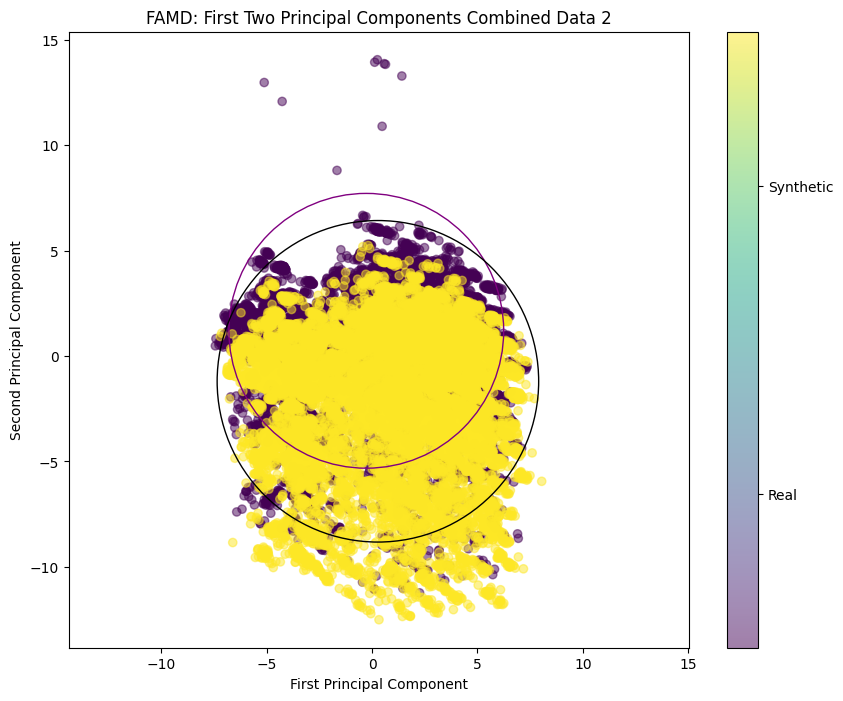

Dataset 2 - Area of 95% CI for Real Data: 133.51
Dataset 2 - Area of 95% CI for Synthetic Data: 182.81
Dataset 2 - Distance between centroids: 2.46
Dataset 2 - Overlap area: 119.90
Dataset 2 - Overlap percentage: 61.04%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


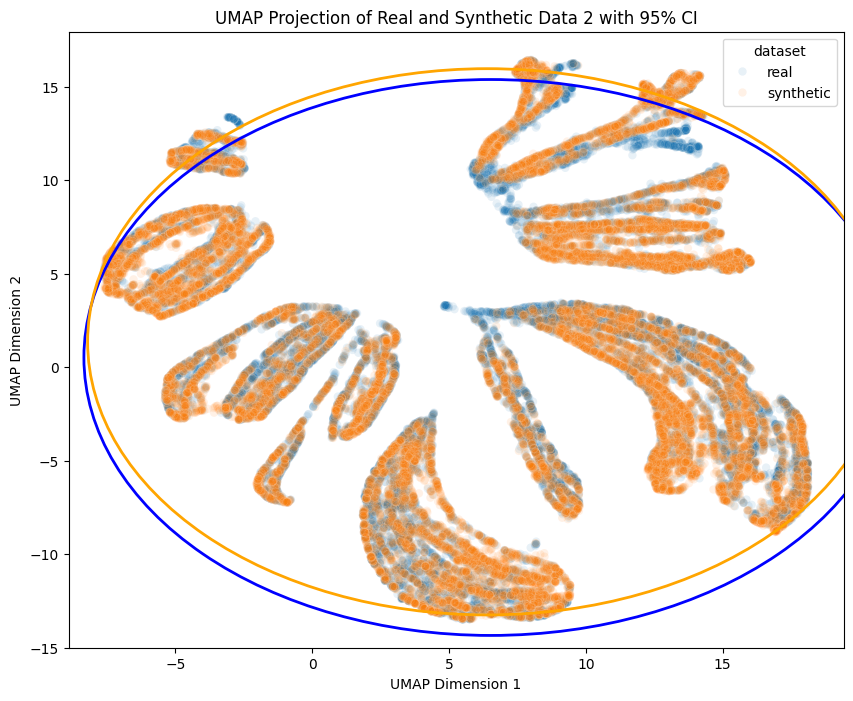

Dataset 2 - Area of 95% CI for Real Data: 694.58
Dataset 2 - Area of 95% CI for Synthetic Data: 670.62
Dataset 2 - Distance between centroids: 0.85
Dataset 2 - Overlap area: 656.44
Dataset 2 - Overlap percentage: 92.62%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


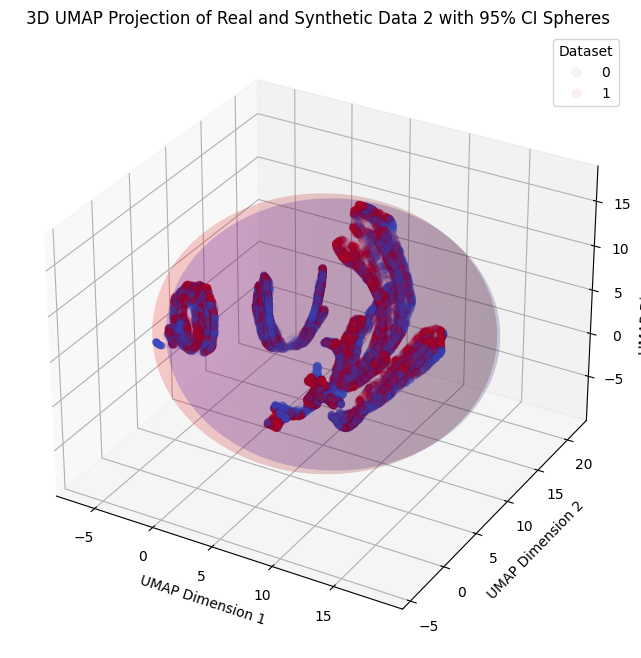

Dataset 2 - Volume of 95% CI for Real Data: 7682.10 cubic units
Dataset 2 - Volume of 95% CI for Synthetic Data: 8356.36 cubic units
Dataset 2 - Distance between centroids: 1.07 units
Dataset 2 - Overlap volume: 7447.88 cubic units
Dataset 2 - Overlap percentage: 86.70%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


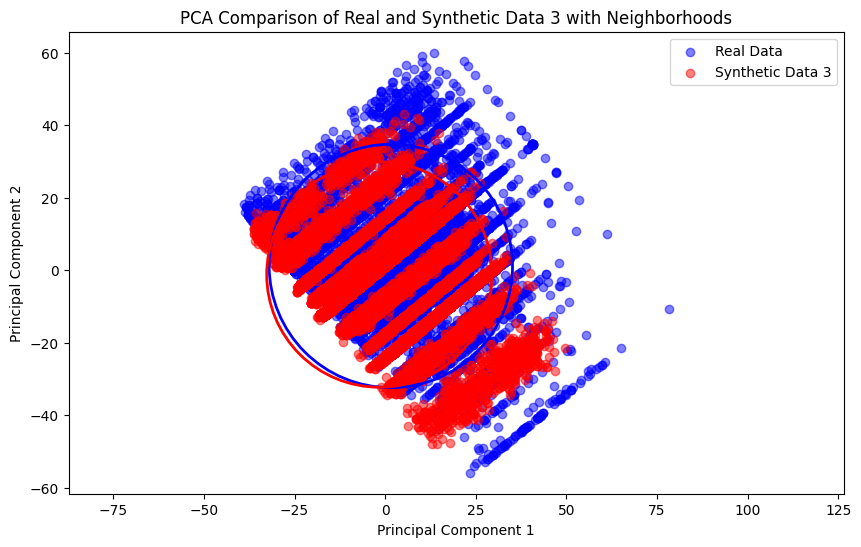

Dataset 3 - Area of 95% CI for Real Data: 3541.16
Dataset 3 - Area of 95% CI for Synthetic Data: 3035.71
Dataset 3 - Distance between centroids: 3.96
Dataset 3 - Overlap area: 2980.12
Dataset 3 - Overlap percentage: 82.86%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


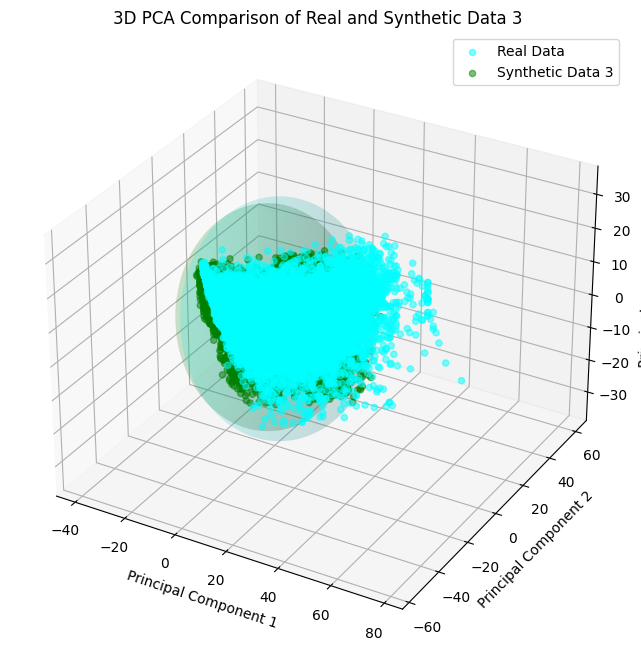

Dataset 3 - Volume of 95% CI for Real Data: 160212.50 cubic units
Dataset 3 - Volume of 95% CI for Synthetic Data: 129096.11 cubic units
Dataset 3 - Distance between centroids: 4.03 units
Dataset 3 - Overlap volume: 126755.91 cubic units
Dataset 3 - Overlap percentage: 77.98%


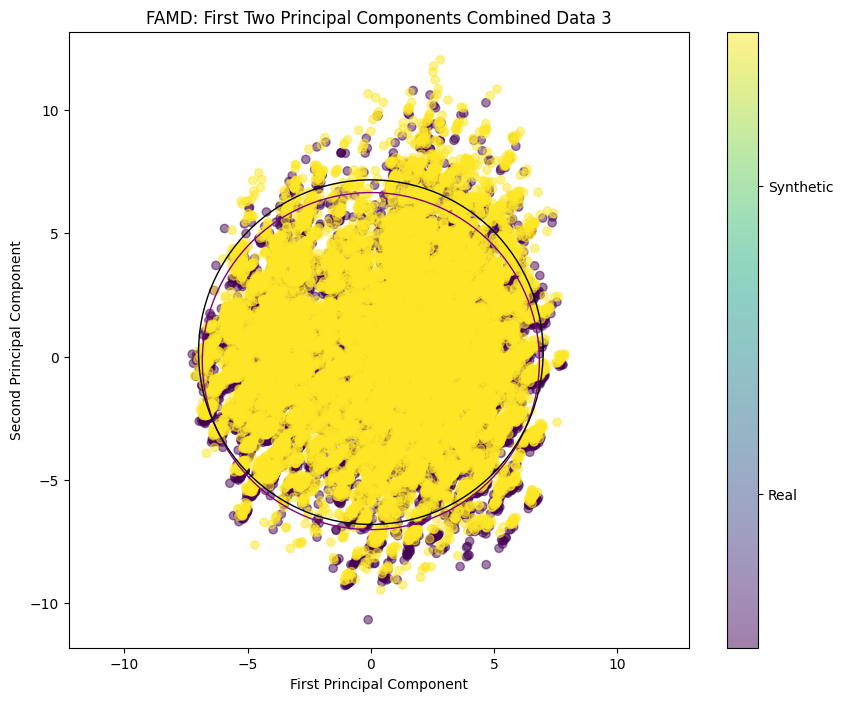

Dataset 3 - Area of 95% CI for Real Data: 146.67
Dataset 3 - Area of 95% CI for Synthetic Data: 153.24
Dataset 3 - Distance between centroids: 0.36
Dataset 3 - Overlap area: 144.50
Dataset 3 - Overlap percentage: 92.98%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


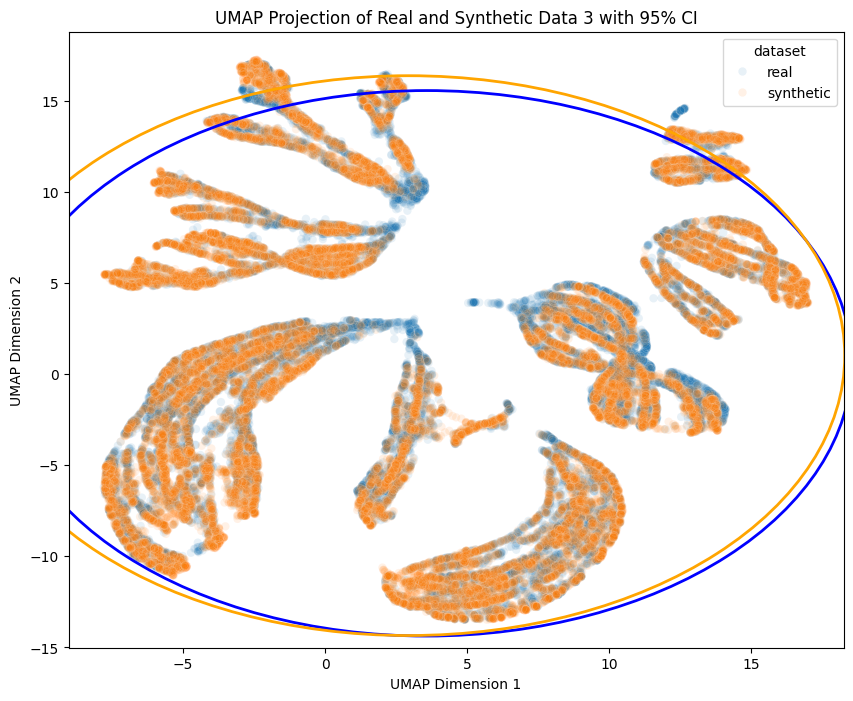

Dataset 3 - Area of 95% CI for Real Data: 703.53
Dataset 3 - Area of 95% CI for Synthetic Data: 740.99
Dataset 3 - Distance between centroids: 0.76
Dataset 3 - Overlap area: 695.94
Dataset 3 - Overlap percentage: 92.97%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


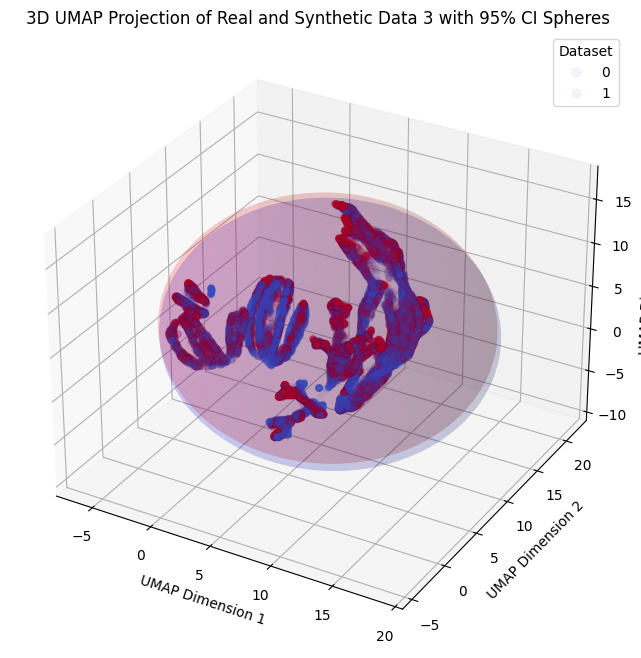

Dataset 3 - Volume of 95% CI for Real Data: 8224.88 cubic units
Dataset 3 - Volume of 95% CI for Synthetic Data: 7975.51 cubic units
Dataset 3 - Distance between centroids: 1.21 units
Dataset 3 - Overlap volume: 7504.53 cubic units
Dataset 3 - Overlap percentage: 86.30%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


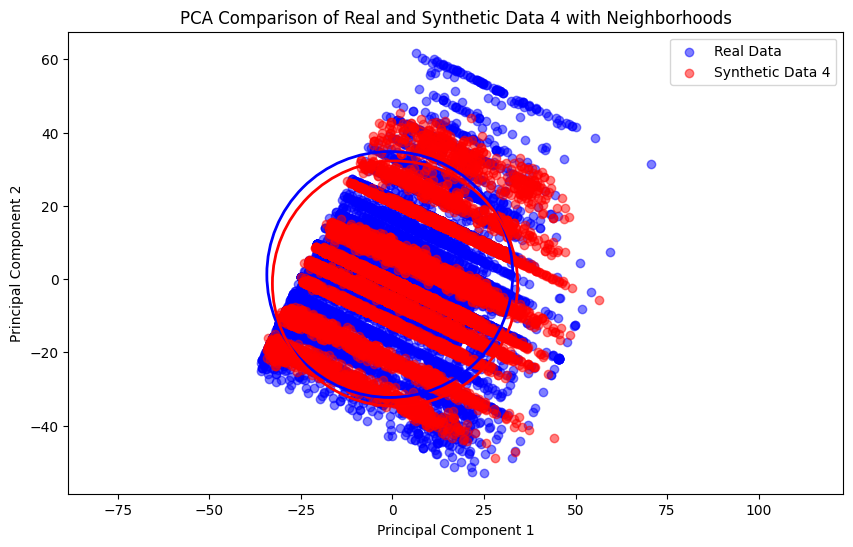

Dataset 4 - Area of 95% CI for Real Data: 3541.45
Dataset 4 - Area of 95% CI for Synthetic Data: 3523.13
Dataset 4 - Distance between centroids: 2.87
Dataset 4 - Overlap area: 3339.85
Dataset 4 - Overlap percentage: 89.67%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


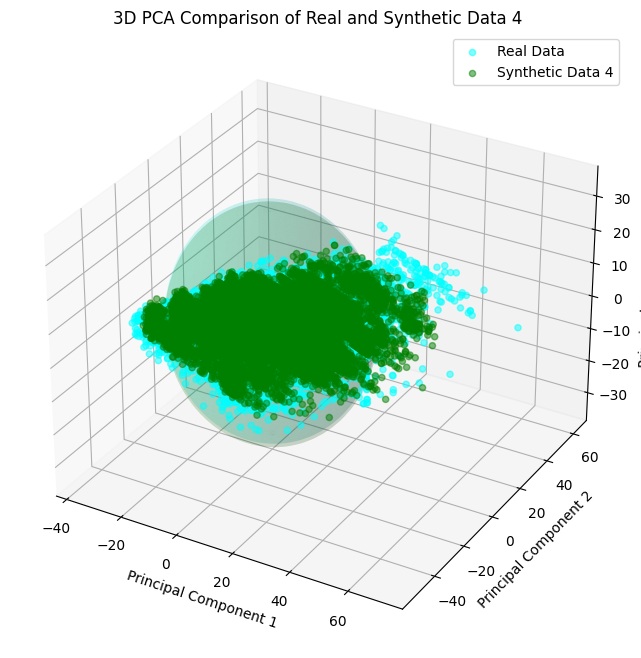

Dataset 4 - Volume of 95% CI for Real Data: 160292.78 cubic units
Dataset 4 - Volume of 95% CI for Synthetic Data: 160033.14 cubic units
Dataset 4 - Distance between centroids: 2.89 units
Dataset 4 - Overlap volume: 149867.34 cubic units
Dataset 4 - Overlap percentage: 87.92%


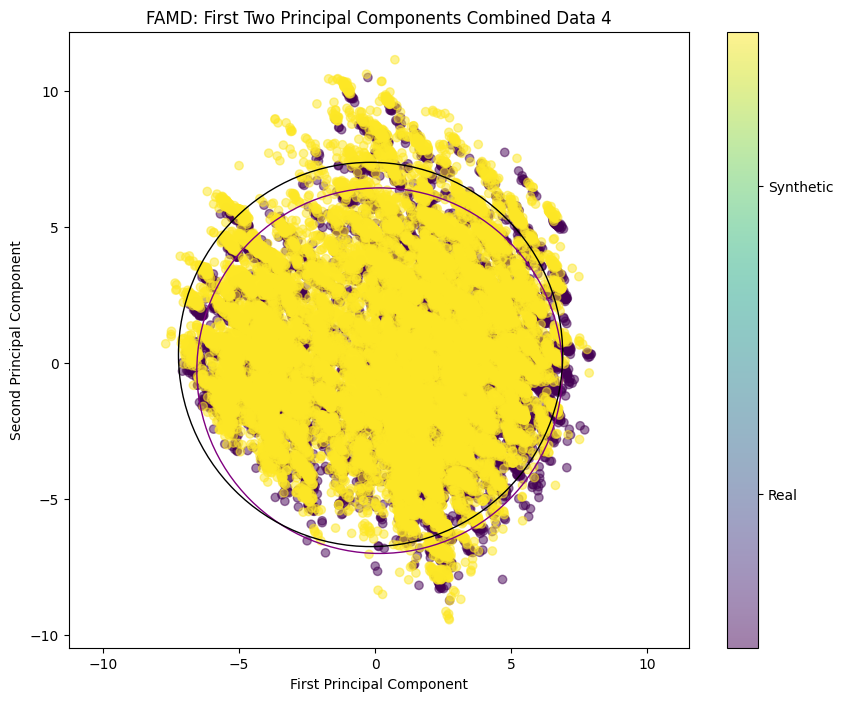

Dataset 4 - Area of 95% CI for Real Data: 141.86
Dataset 4 - Area of 95% CI for Synthetic Data: 156.72
Dataset 4 - Distance between centroids: 0.68
Dataset 4 - Overlap area: 138.67
Dataset 4 - Overlap percentage: 86.72%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


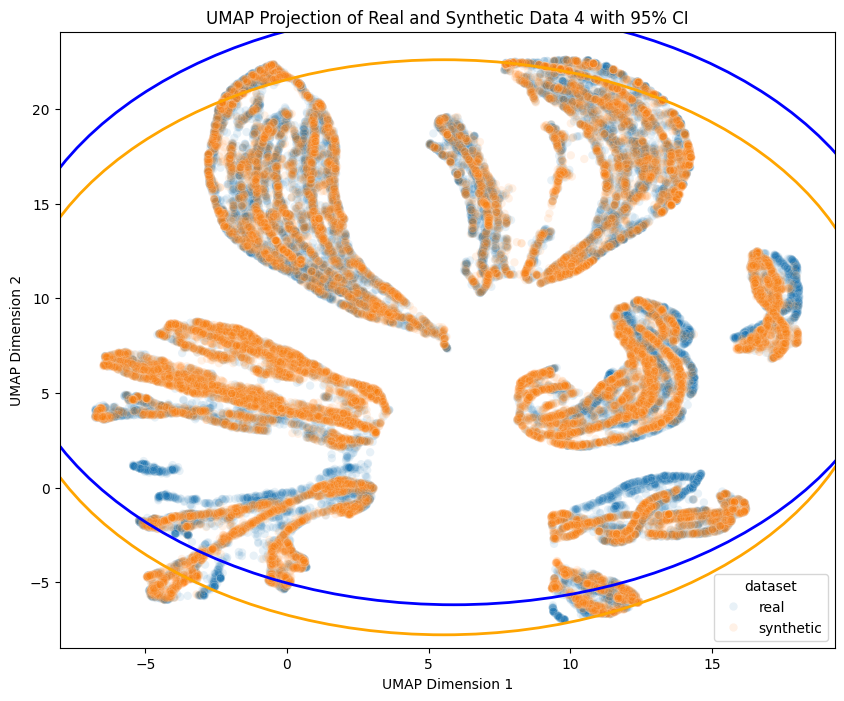

Dataset 4 - Area of 95% CI for Real Data: 778.03
Dataset 4 - Area of 95% CI for Synthetic Data: 725.43
Dataset 4 - Distance between centroids: 2.16
Dataset 4 - Overlap area: 682.89
Dataset 4 - Overlap percentage: 83.22%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


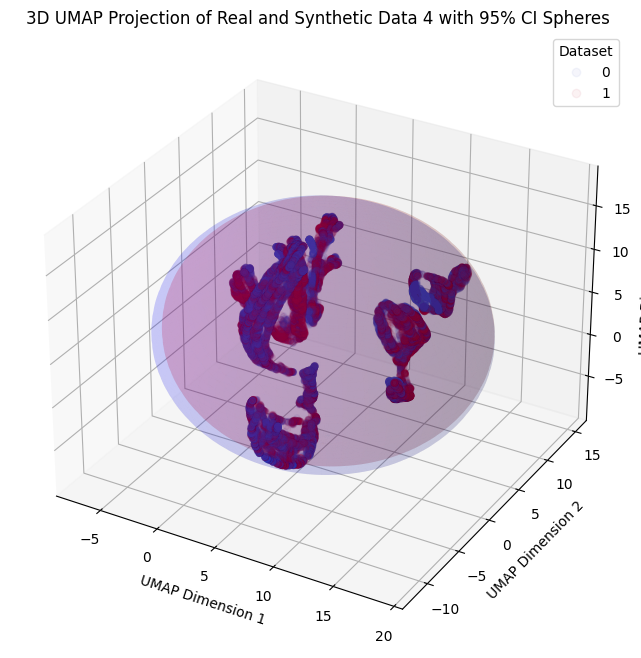

Dataset 4 - Volume of 95% CI for Real Data: 9054.62 cubic units
Dataset 4 - Volume of 95% CI for Synthetic Data: 8365.91 cubic units
Dataset 4 - Distance between centroids: 1.56 units
Dataset 4 - Overlap volume: 7877.95 cubic units
Dataset 4 - Overlap percentage: 82.56%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


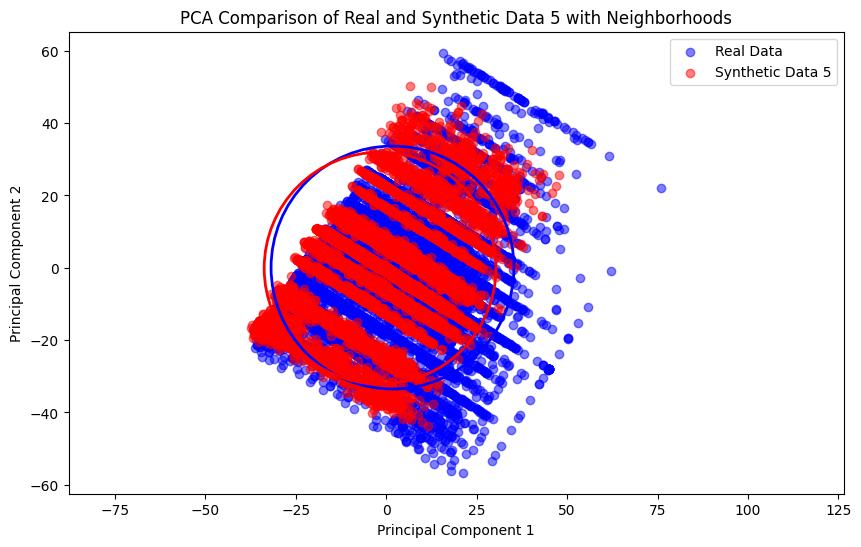

Dataset 5 - Area of 95% CI for Real Data: 3541.80
Dataset 5 - Area of 95% CI for Synthetic Data: 3225.23
Dataset 5 - Distance between centroids: 3.44
Dataset 5 - Overlap area: 3134.93
Dataset 5 - Overlap percentage: 86.31%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


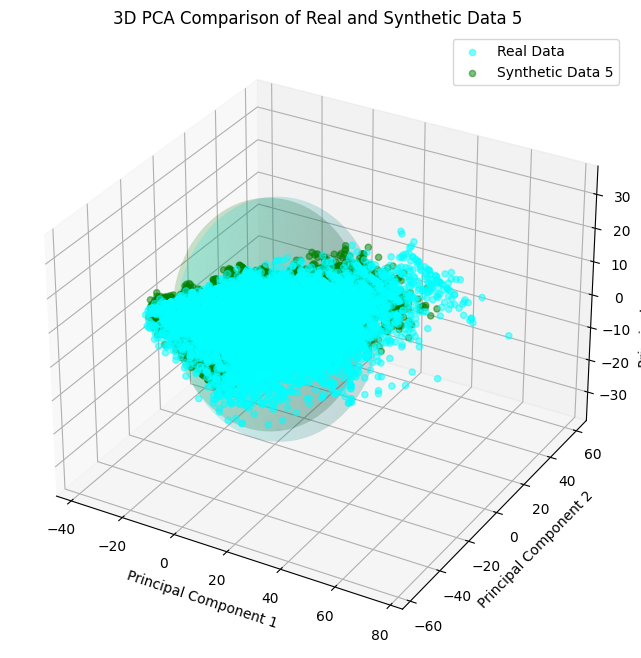

Dataset 5 - Volume of 95% CI for Real Data: 160280.63 cubic units
Dataset 5 - Volume of 95% CI for Synthetic Data: 139199.26 cubic units
Dataset 5 - Distance between centroids: 3.51 units
Dataset 5 - Overlap volume: 135460.31 cubic units
Dataset 5 - Overlap percentage: 82.59%


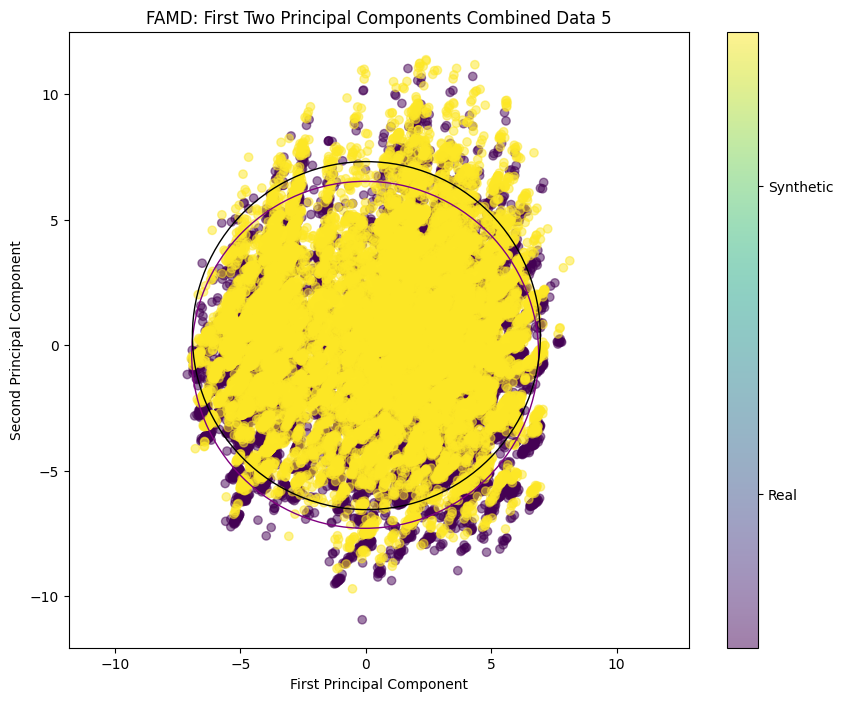

Dataset 5 - Area of 95% CI for Real Data: 150.23
Dataset 5 - Area of 95% CI for Synthetic Data: 151.11
Dataset 5 - Distance between centroids: 0.77
Dataset 5 - Overlap area: 140.05
Dataset 5 - Overlap percentage: 86.83%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


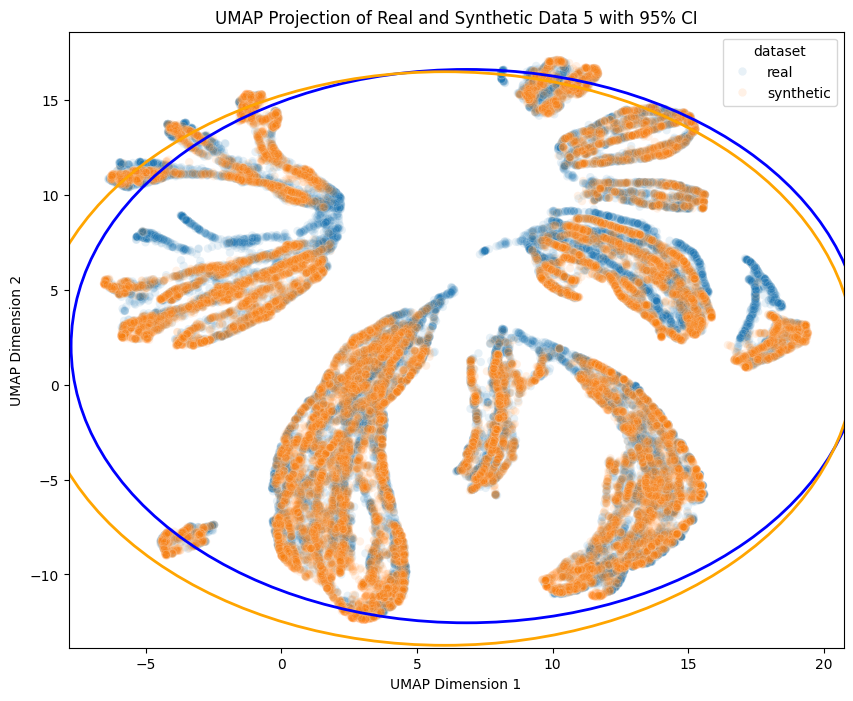

Dataset 5 - Area of 95% CI for Real Data: 668.77
Dataset 5 - Area of 95% CI for Synthetic Data: 718.56
Dataset 5 - Distance between centroids: 1.04
Dataset 5 - Overlap area: 658.69
Dataset 5 - Overlap percentage: 90.40%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


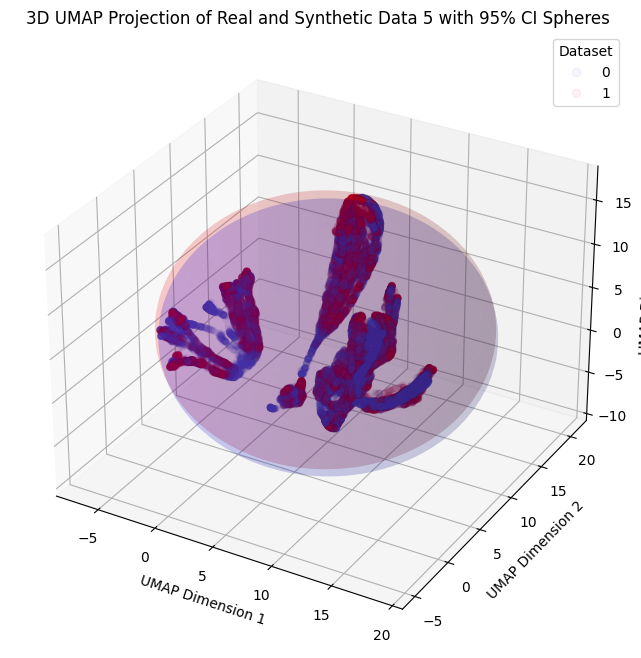

Dataset 5 - Volume of 95% CI for Real Data: 8488.66 cubic units
Dataset 5 - Volume of 95% CI for Synthetic Data: 8615.81 cubic units
Dataset 5 - Distance between centroids: 0.73 units
Dataset 5 - Overlap volume: 8181.10 cubic units
Dataset 5 - Overlap percentage: 91.68%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


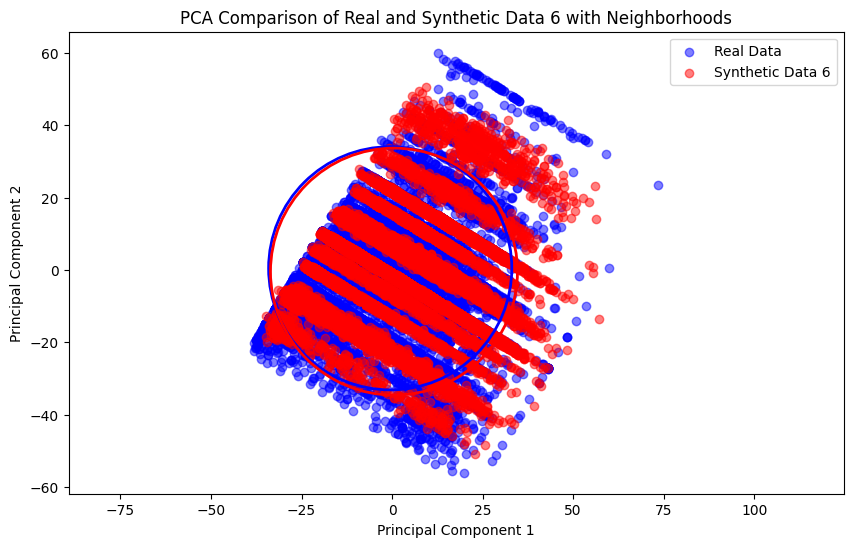

Dataset 6 - Area of 95% CI for Real Data: 3541.47
Dataset 6 - Area of 95% CI for Synthetic Data: 3652.93
Dataset 6 - Distance between centroids: 1.38
Dataset 6 - Overlap area: 3496.86
Dataset 6 - Overlap percentage: 94.57%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


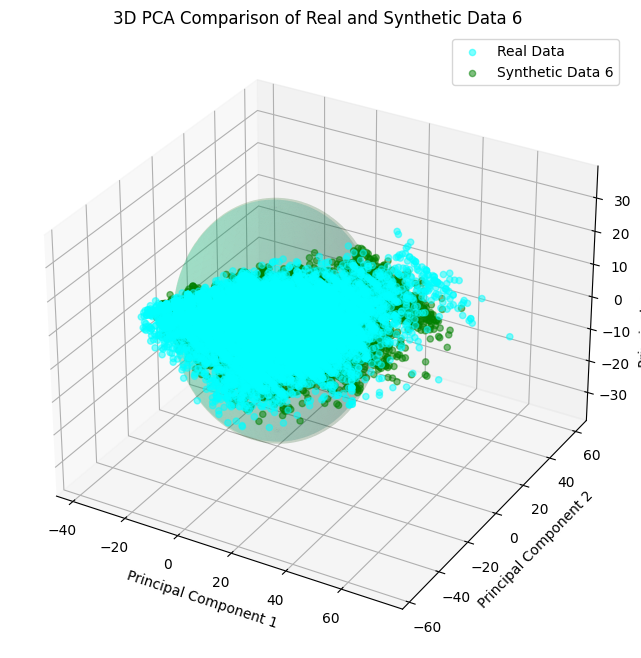

Dataset 6 - Volume of 95% CI for Real Data: 160284.14 cubic units
Dataset 6 - Volume of 95% CI for Synthetic Data: 167460.74 cubic units
Dataset 6 - Distance between centroids: 1.49 units
Dataset 6 - Overlap volume: 157880.01 cubic units
Dataset 6 - Overlap percentage: 92.94%


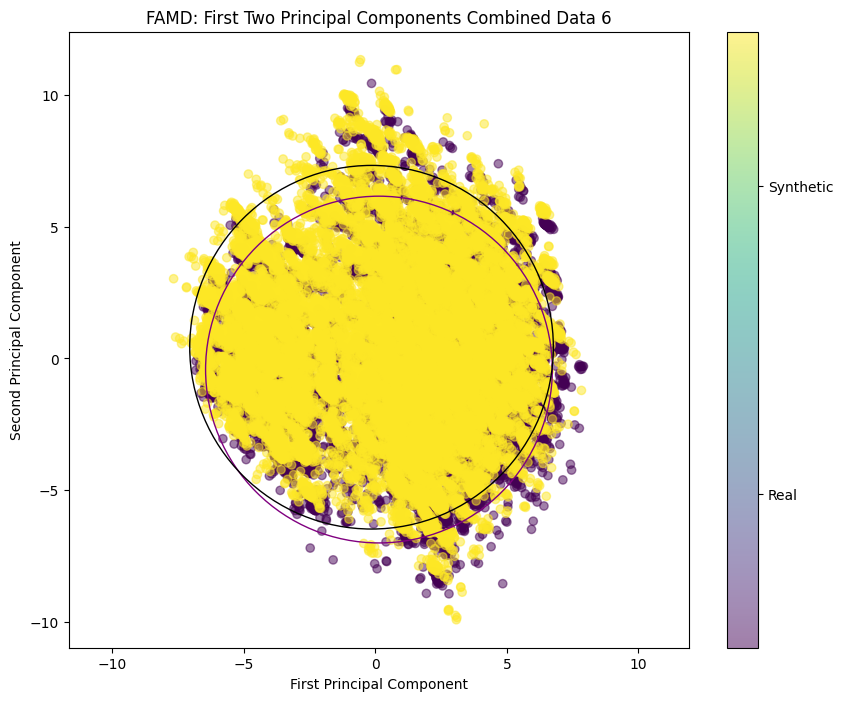

Dataset 6 - Area of 95% CI for Real Data: 136.26
Dataset 6 - Area of 95% CI for Synthetic Data: 149.84
Dataset 6 - Distance between centroids: 0.89
Dataset 6 - Overlap area: 130.21
Dataset 6 - Overlap percentage: 83.53%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


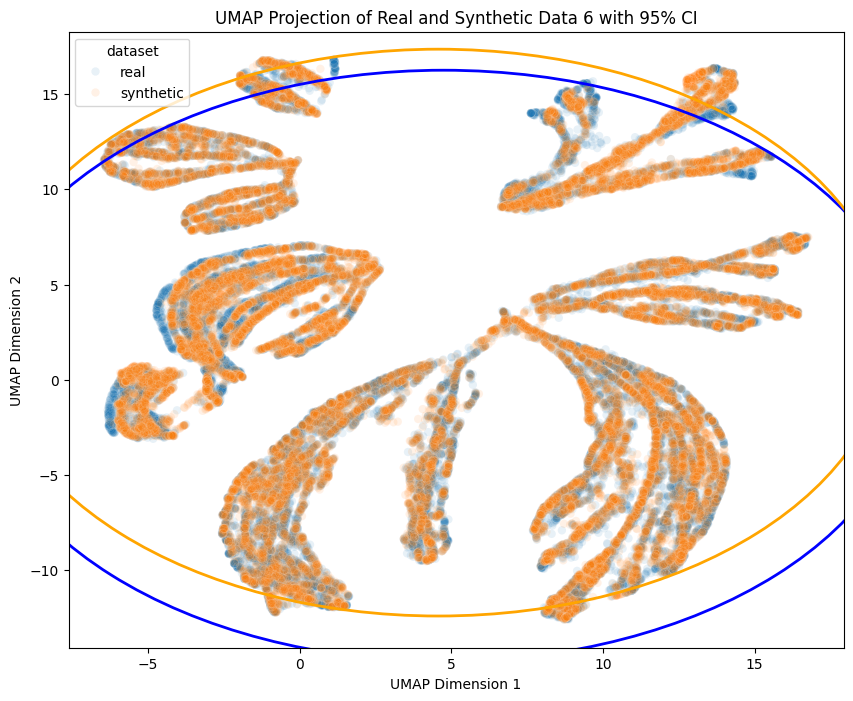

Dataset 6 - Area of 95% CI for Real Data: 756.00
Dataset 6 - Area of 95% CI for Synthetic Data: 694.83
Dataset 6 - Distance between centroids: 1.75
Dataset 6 - Overlap area: 668.57
Dataset 6 - Overlap percentage: 85.47%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


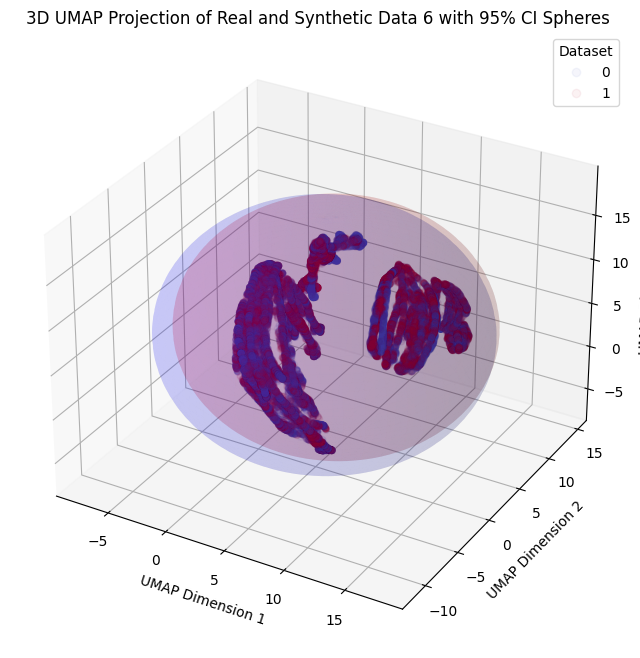

Dataset 6 - Volume of 95% CI for Real Data: 8692.11 cubic units
Dataset 6 - Volume of 95% CI for Synthetic Data: 7502.41 cubic units
Dataset 6 - Distance between centroids: 1.30 units
Dataset 6 - Overlap volume: 7323.42 cubic units
Dataset 6 - Overlap percentage: 82.55%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


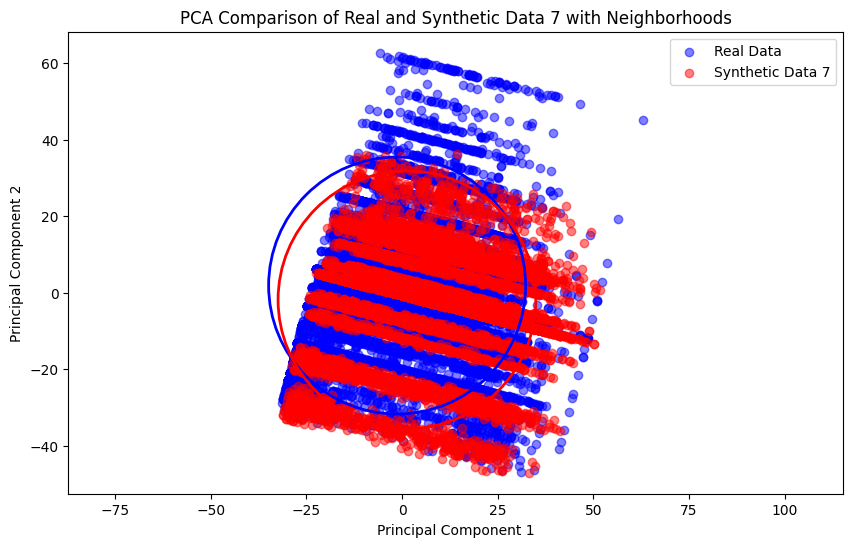

Dataset 7 - Area of 95% CI for Real Data: 3540.73
Dataset 7 - Area of 95% CI for Synthetic Data: 3561.12
Dataset 7 - Distance between centroids: 4.54
Dataset 7 - Overlap area: 3246.12
Dataset 7 - Overlap percentage: 84.19%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


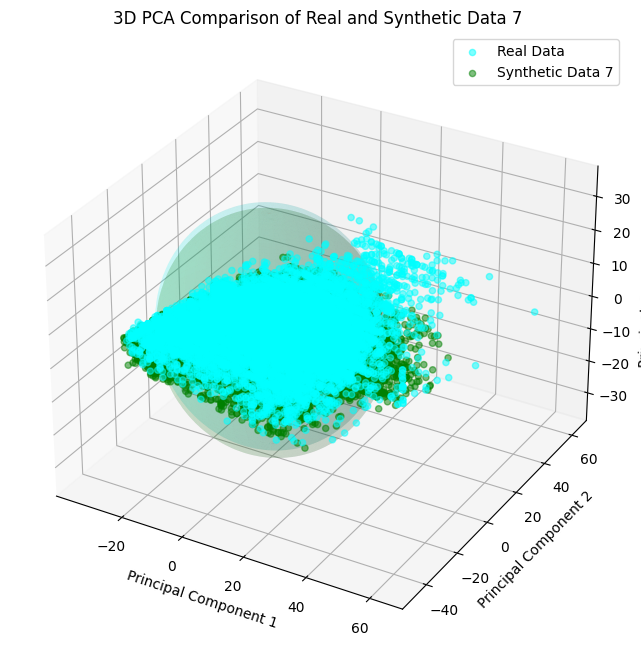

Dataset 7 - Volume of 95% CI for Real Data: 160321.04 cubic units
Dataset 7 - Volume of 95% CI for Synthetic Data: 162199.02 cubic units
Dataset 7 - Distance between centroids: 4.54 units
Dataset 7 - Overlap volume: 145002.40 cubic units
Dataset 7 - Overlap percentage: 81.68%


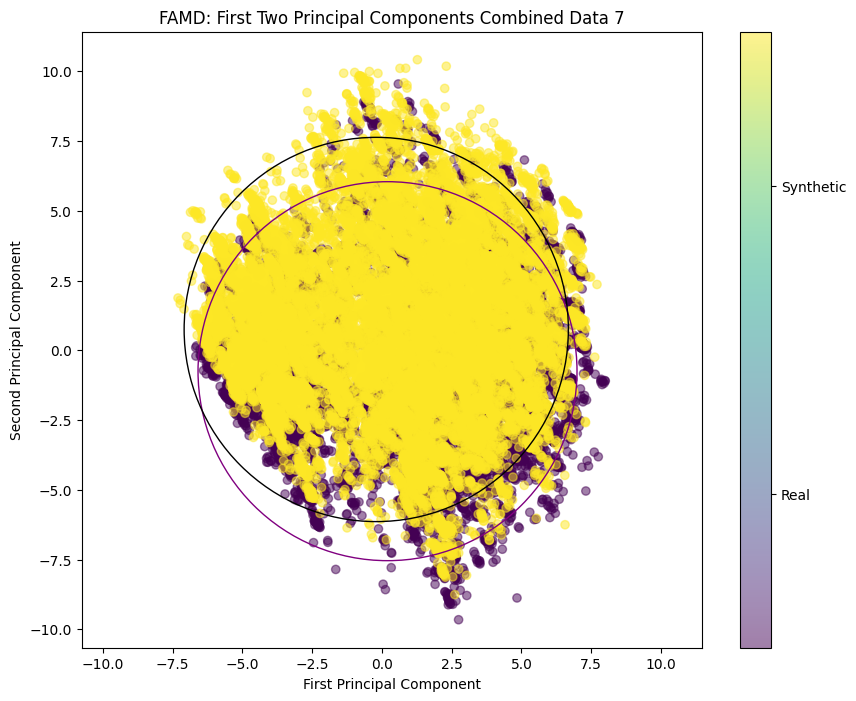

Dataset 7 - Area of 95% CI for Real Data: 144.90
Dataset 7 - Area of 95% CI for Synthetic Data: 148.96
Dataset 7 - Distance between centroids: 1.55
Dataset 7 - Overlap area: 125.76
Dataset 7 - Overlap percentage: 74.81%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


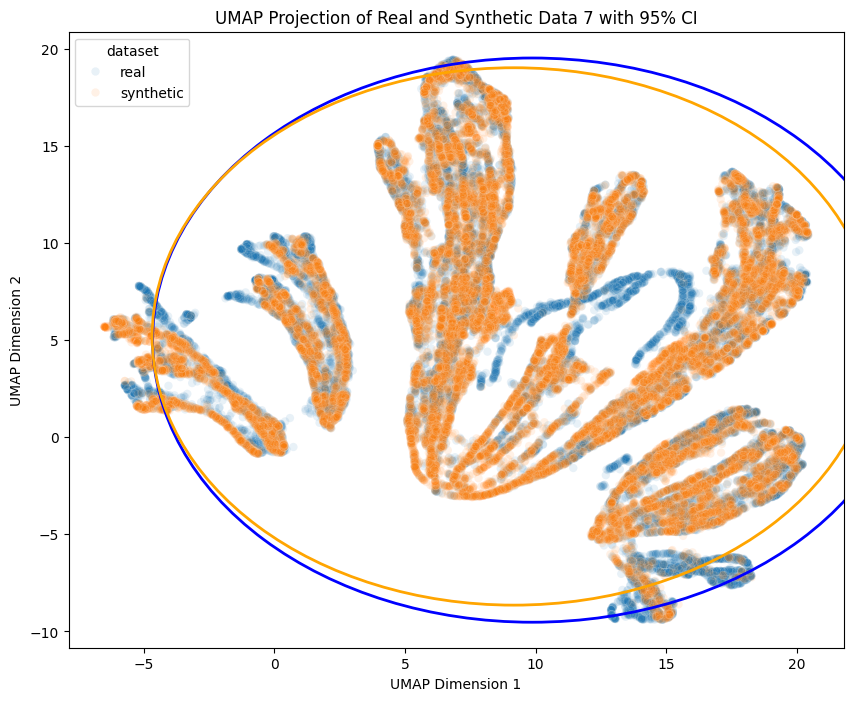

Dataset 7 - Area of 95% CI for Real Data: 663.85
Dataset 7 - Area of 95% CI for Synthetic Data: 602.21
Dataset 7 - Distance between centroids: 0.73
Dataset 7 - Overlap area: 601.95
Dataset 7 - Overlap percentage: 90.64%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


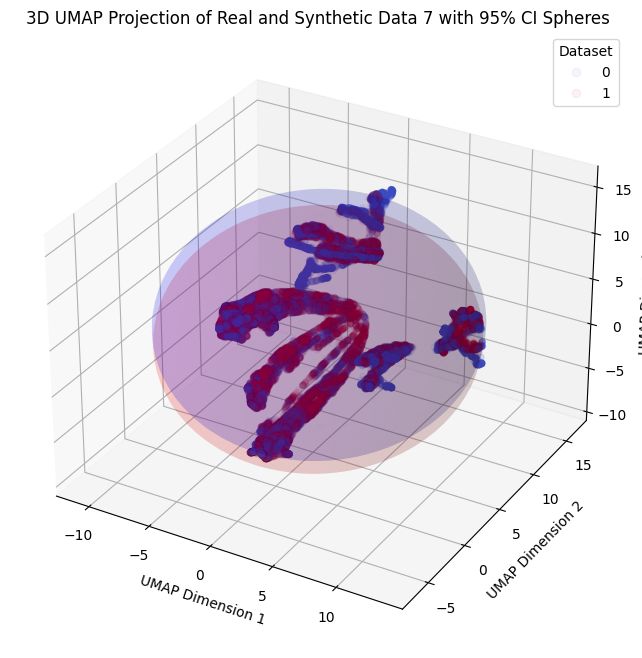

Dataset 7 - Volume of 95% CI for Real Data: 6545.91 cubic units
Dataset 7 - Volume of 95% CI for Synthetic Data: 6326.46 cubic units
Dataset 7 - Distance between centroids: 1.57 units
Dataset 7 - Overlap volume: 5774.36 cubic units
Dataset 7 - Overlap percentage: 81.35%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


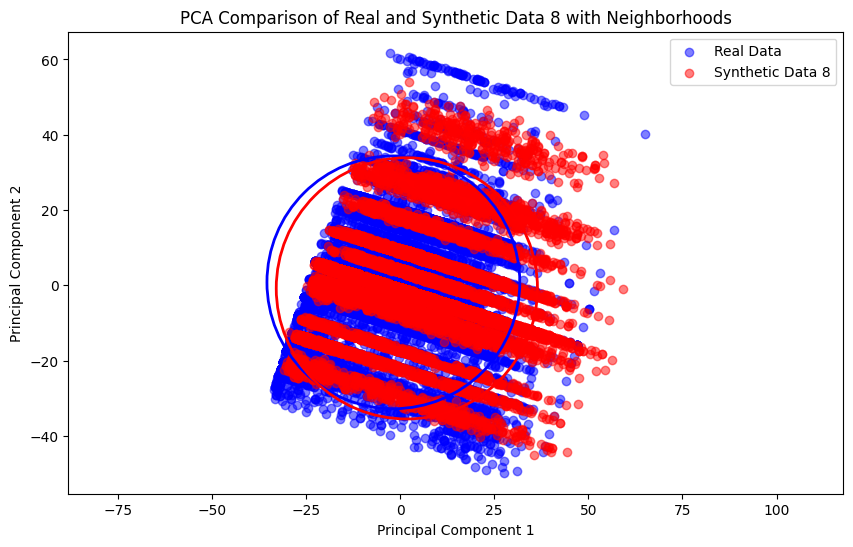

Dataset 8 - Area of 95% CI for Real Data: 3541.75
Dataset 8 - Area of 95% CI for Synthetic Data: 3780.39
Dataset 8 - Distance between centroids: 3.92
Dataset 8 - Overlap area: 3382.46
Dataset 8 - Overlap percentage: 85.86%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


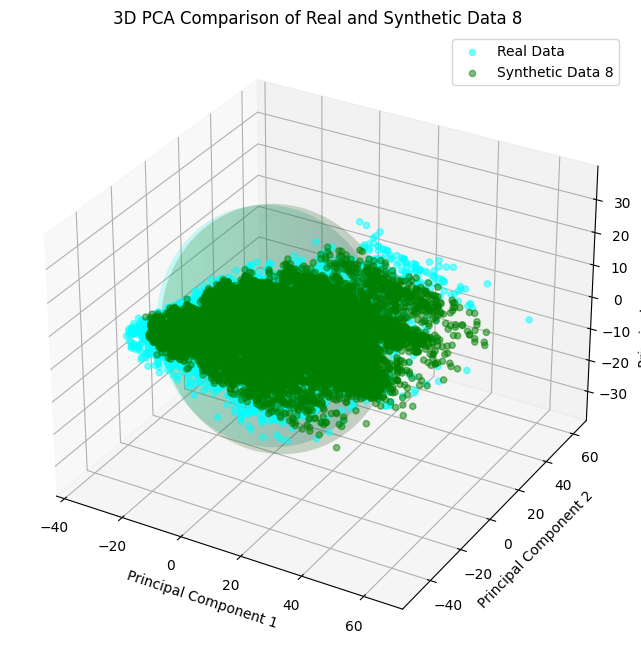

Dataset 8 - Volume of 95% CI for Real Data: 160259.74 cubic units
Dataset 8 - Volume of 95% CI for Synthetic Data: 175379.38 cubic units
Dataset 8 - Distance between centroids: 3.97 units
Dataset 8 - Overlap volume: 152268.40 cubic units
Dataset 8 - Overlap percentage: 83.04%


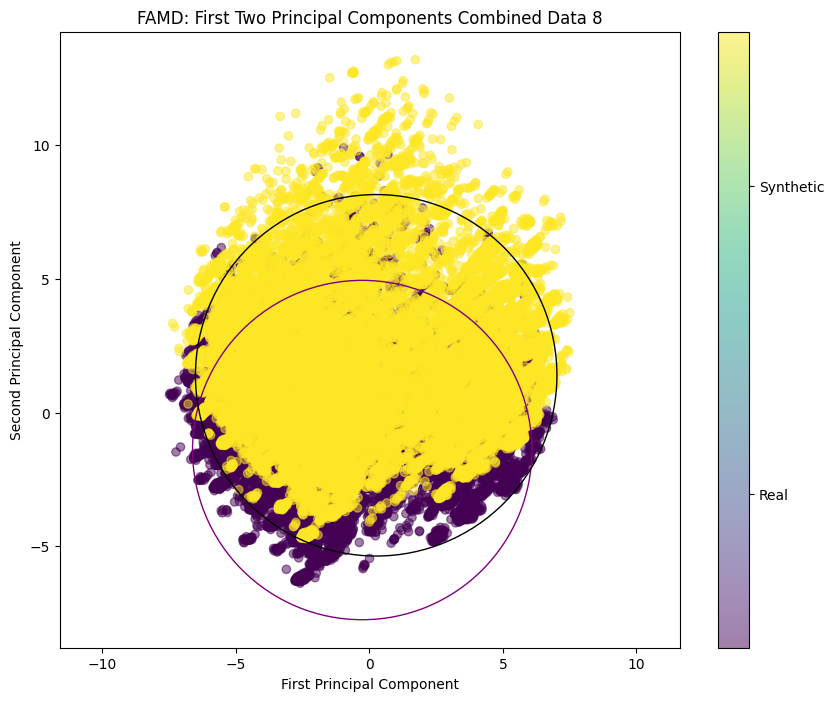

Dataset 8 - Area of 95% CI for Real Data: 126.61
Dataset 8 - Area of 95% CI for Synthetic Data: 143.65
Dataset 8 - Distance between centroids: 2.85
Dataset 8 - Overlap area: 97.72
Dataset 8 - Overlap percentage: 56.63%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


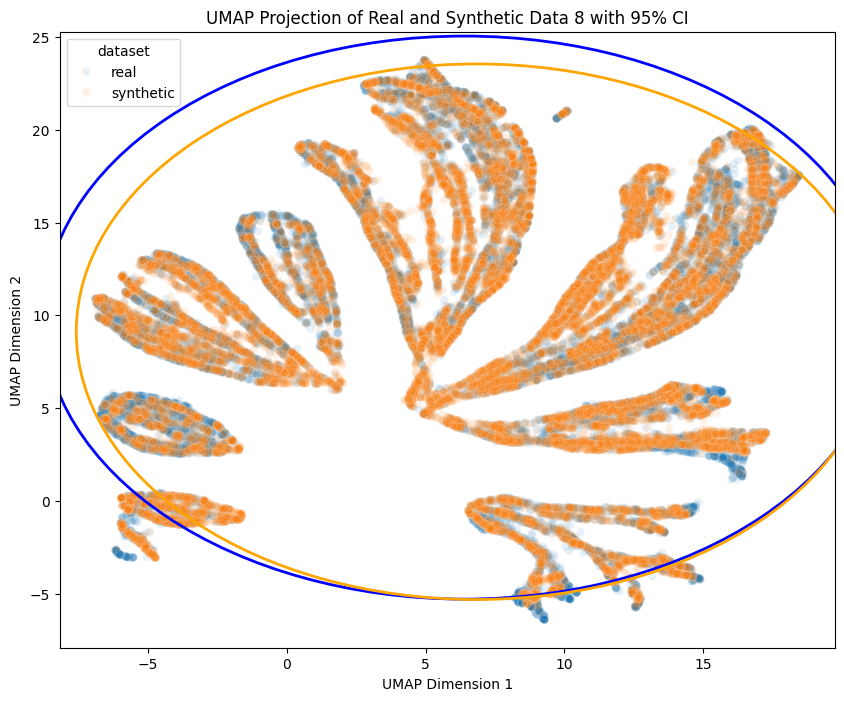

Dataset 8 - Area of 95% CI for Real Data: 722.61
Dataset 8 - Area of 95% CI for Synthetic Data: 653.76
Dataset 8 - Distance between centroids: 0.88
Dataset 8 - Overlap area: 652.19
Dataset 8 - Overlap percentage: 90.06%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


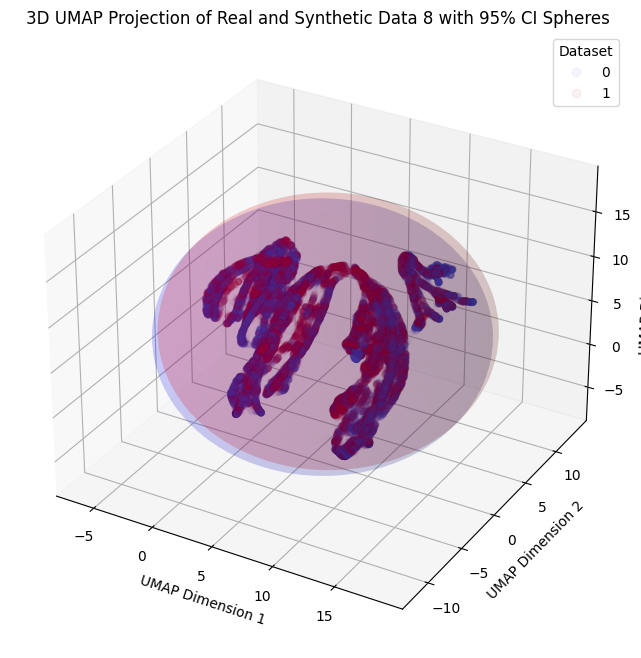

Dataset 8 - Volume of 95% CI for Real Data: 7844.69 cubic units
Dataset 8 - Volume of 95% CI for Synthetic Data: 7841.90 cubic units
Dataset 8 - Distance between centroids: 0.75 units
Dataset 8 - Overlap volume: 7485.58 cubic units
Dataset 8 - Overlap percentage: 91.28%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


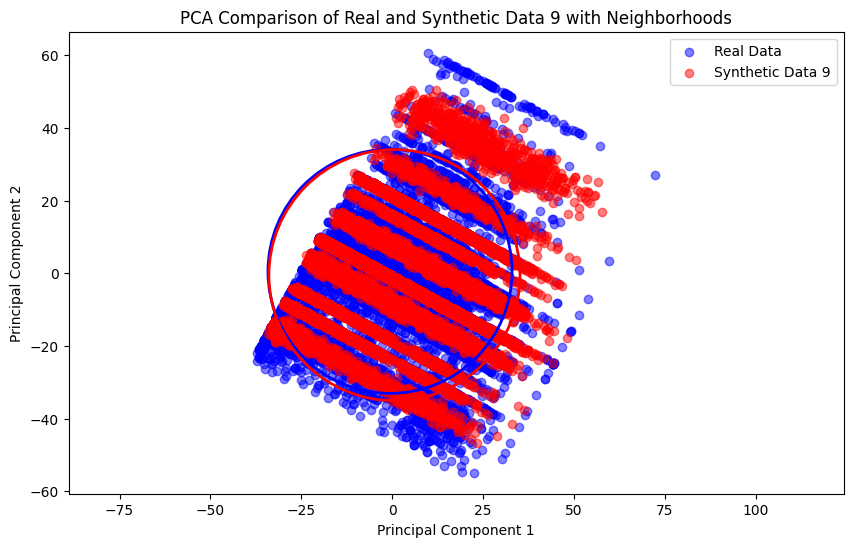

Dataset 9 - Area of 95% CI for Real Data: 3541.14
Dataset 9 - Area of 95% CI for Synthetic Data: 3747.66
Dataset 9 - Distance between centroids: 1.61
Dataset 9 - Overlap area: 3514.46
Dataset 9 - Overlap percentage: 93.11%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


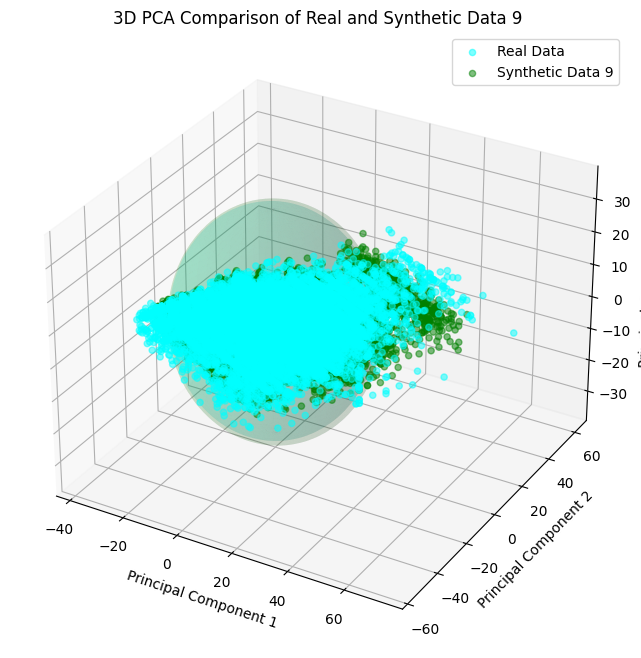

Dataset 9 - Volume of 95% CI for Real Data: 160281.40 cubic units
Dataset 9 - Volume of 95% CI for Synthetic Data: 174386.37 cubic units
Dataset 9 - Distance between centroids: 1.64 units
Dataset 9 - Overlap volume: 159245.95 cubic units
Dataset 9 - Overlap percentage: 90.78%


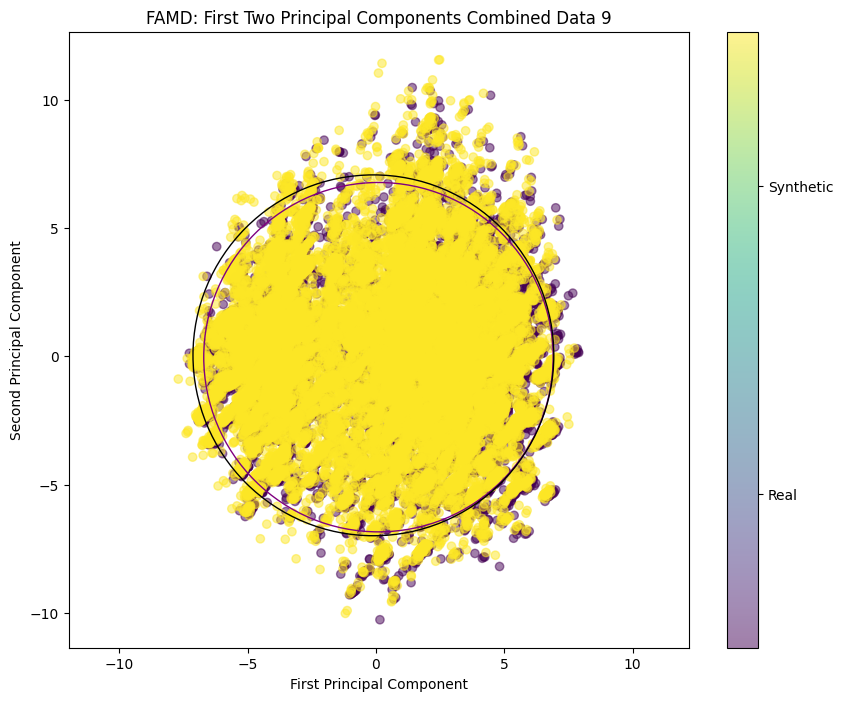

Dataset 9 - Area of 95% CI for Real Data: 145.53
Dataset 9 - Area of 95% CI for Synthetic Data: 155.22
Dataset 9 - Distance between centroids: 0.21
Dataset 9 - Overlap area: 145.53
Dataset 9 - Overlap percentage: 93.75%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


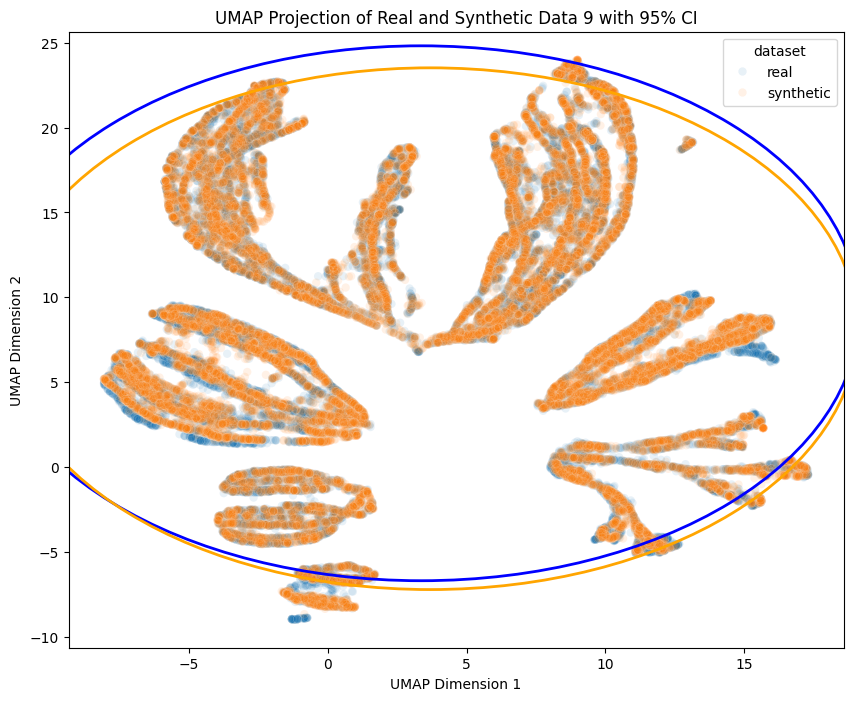

Dataset 9 - Area of 95% CI for Real Data: 780.73
Dataset 9 - Area of 95% CI for Synthetic Data: 742.76
Dataset 9 - Distance between centroids: 0.97
Dataset 9 - Overlap area: 729.17
Dataset 9 - Overlap percentage: 91.80%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


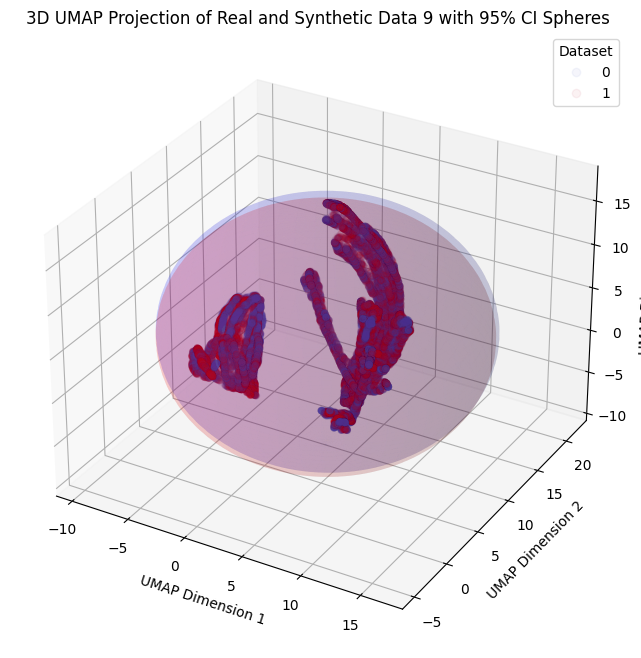

Dataset 9 - Volume of 95% CI for Real Data: 9228.98 cubic units
Dataset 9 - Volume of 95% CI for Synthetic Data: 8912.04 cubic units
Dataset 9 - Distance between centroids: 0.70 units
Dataset 9 - Overlap volume: 8687.01 cubic units
Dataset 9 - Overlap percentage: 91.89%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


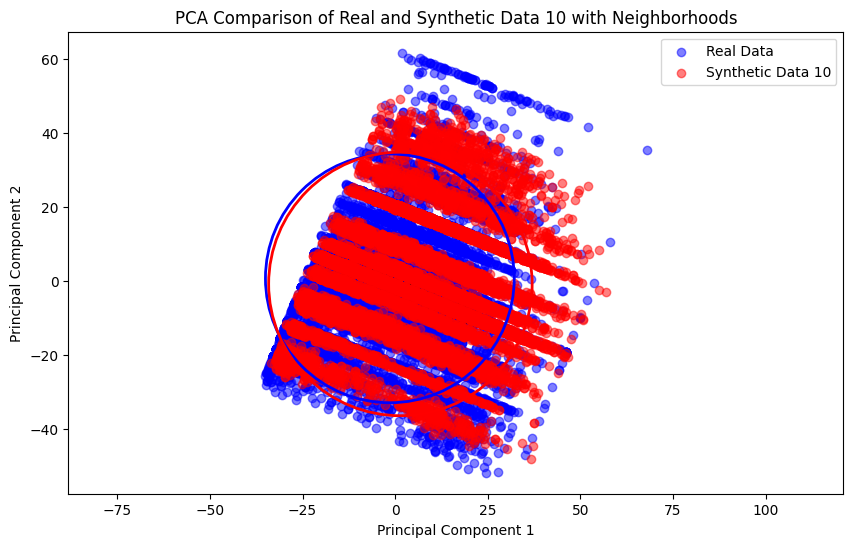

Dataset 10 - Area of 95% CI for Real Data: 3542.03
Dataset 10 - Area of 95% CI for Synthetic Data: 3973.20
Dataset 10 - Distance between centroids: 3.23
Dataset 10 - Overlap area: 3490.72
Dataset 10 - Overlap percentage: 86.74%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


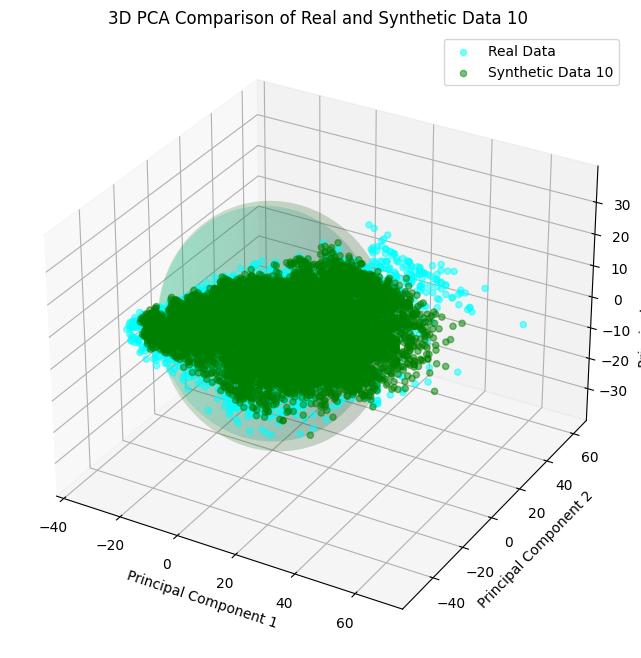

Dataset 10 - Volume of 95% CI for Real Data: 160336.55 cubic units
Dataset 10 - Volume of 95% CI for Synthetic Data: 190836.78 cubic units
Dataset 10 - Distance between centroids: 3.27 units
Dataset 10 - Overlap volume: 158522.99 cubic units
Dataset 10 - Overlap percentage: 82.29%


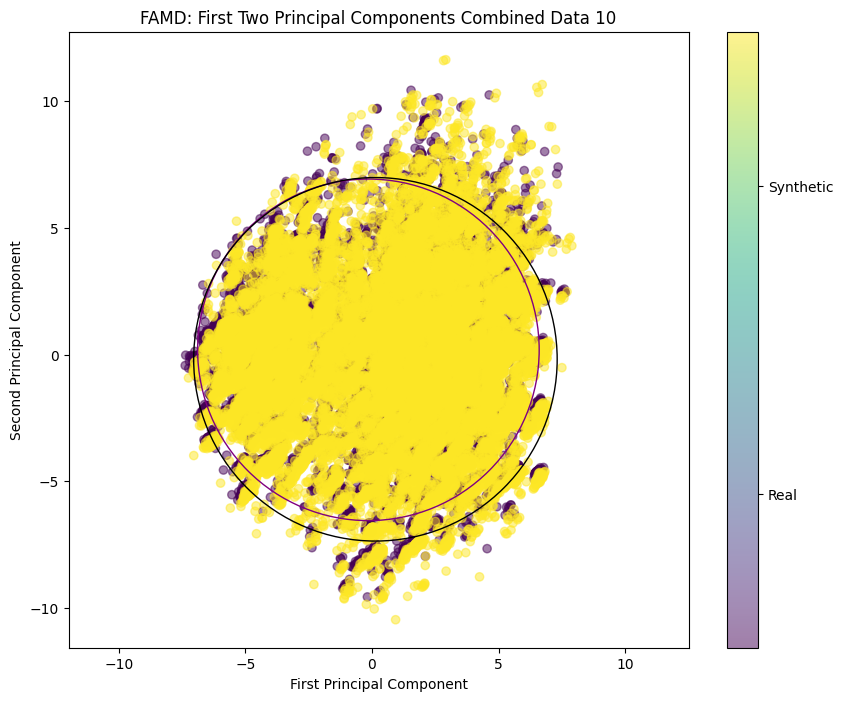

Dataset 10 - Area of 95% CI for Real Data: 142.86
Dataset 10 - Area of 95% CI for Synthetic Data: 161.81
Dataset 10 - Distance between centroids: 0.47
Dataset 10 - Overlap area: 142.75
Dataset 10 - Overlap percentage: 88.16%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


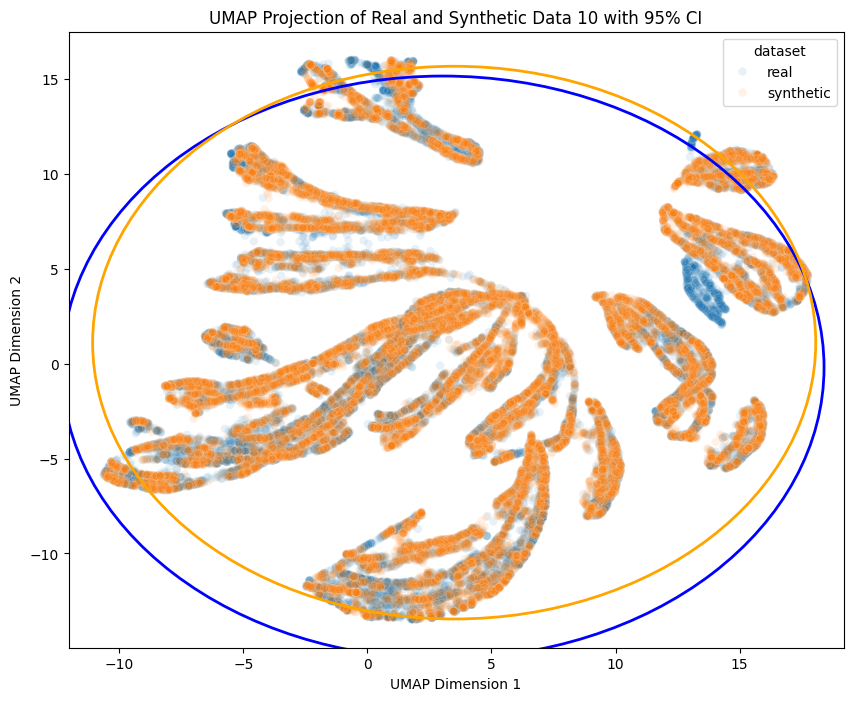

Dataset 10 - Area of 95% CI for Real Data: 741.34
Dataset 10 - Area of 95% CI for Synthetic Data: 667.02
Dataset 10 - Distance between centroids: 1.38
Dataset 10 - Overlap area: 655.83
Dataset 10 - Overlap percentage: 87.15%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


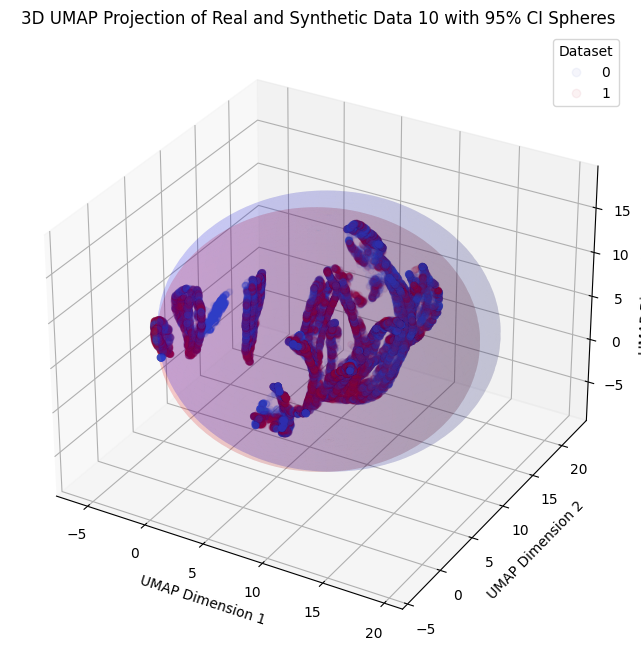

Dataset 10 - Volume of 95% CI for Real Data: 8694.90 cubic units
Dataset 10 - Volume of 95% CI for Synthetic Data: 7215.19 cubic units
Dataset 10 - Distance between centroids: 1.12 units
Dataset 10 - Overlap volume: 7161.90 cubic units
Dataset 10 - Overlap percentage: 81.87%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


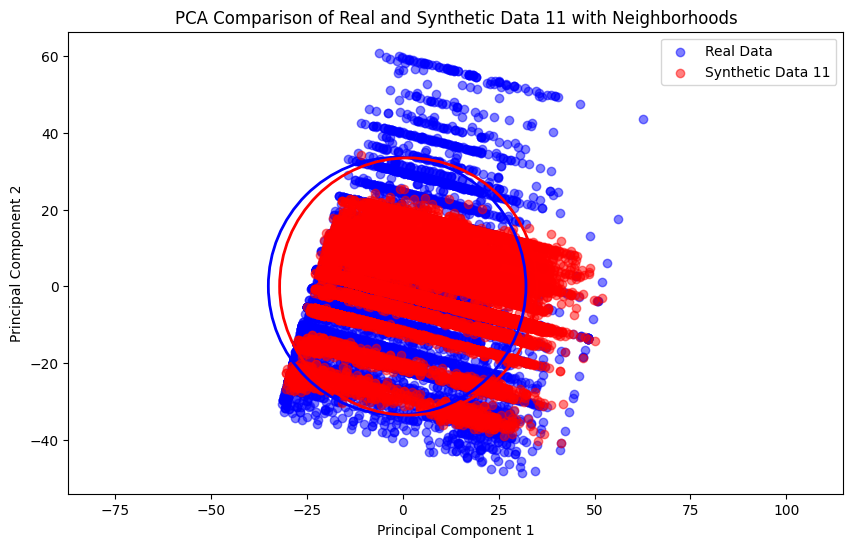

Dataset 11 - Area of 95% CI for Real Data: 3541.19
Dataset 11 - Area of 95% CI for Synthetic Data: 3529.55
Dataset 11 - Distance between centroids: 2.88
Dataset 11 - Overlap area: 3341.87
Dataset 11 - Overlap percentage: 89.62%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


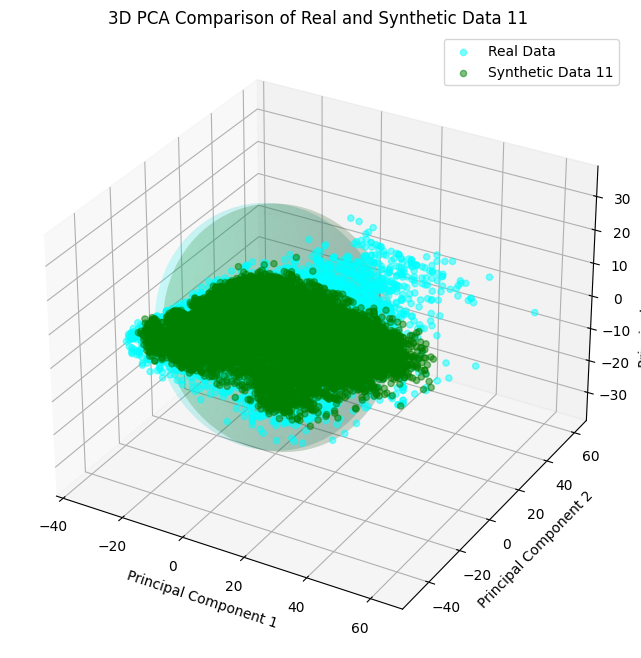

Dataset 11 - Volume of 95% CI for Real Data: 160305.30 cubic units
Dataset 11 - Volume of 95% CI for Synthetic Data: 160613.25 cubic units
Dataset 11 - Distance between centroids: 2.93 units
Dataset 11 - Overlap volume: 149998.04 cubic units
Dataset 11 - Overlap percentage: 87.76%


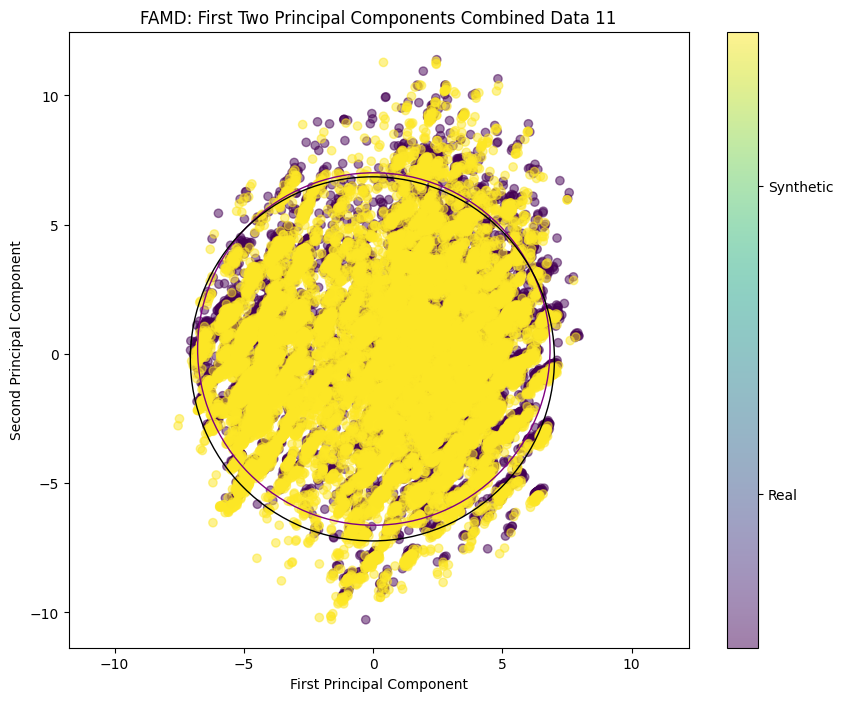

Dataset 11 - Area of 95% CI for Real Data: 146.00
Dataset 11 - Area of 95% CI for Synthetic Data: 155.83
Dataset 11 - Distance between centroids: 0.39
Dataset 11 - Overlap area: 144.62
Dataset 11 - Overlap percentage: 92.00%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


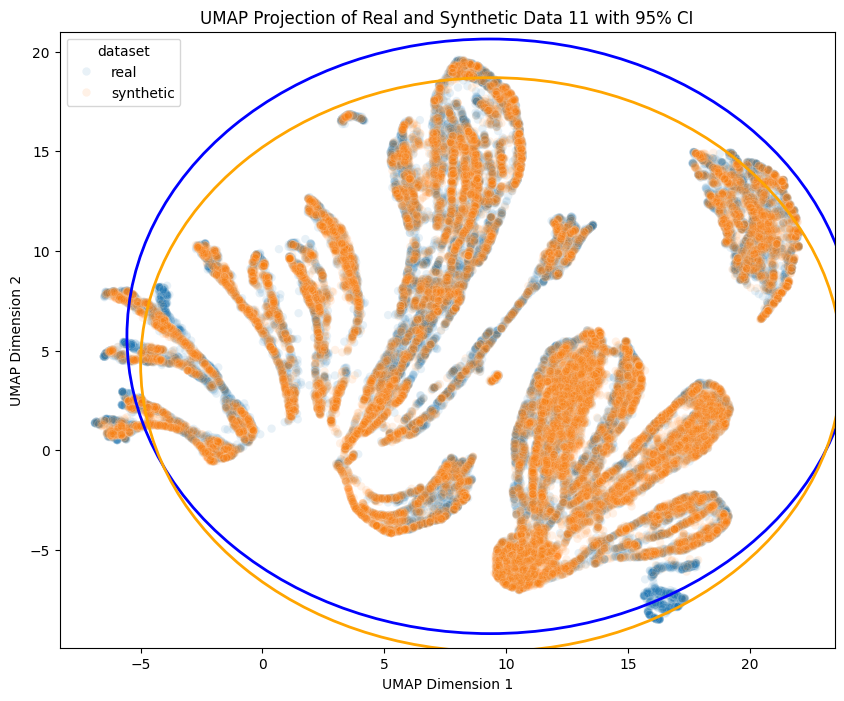

Dataset 11 - Area of 95% CI for Real Data: 698.36
Dataset 11 - Area of 95% CI for Synthetic Data: 650.30
Dataset 11 - Distance between centroids: 1.42
Dataset 11 - Overlap area: 629.95
Dataset 11 - Overlap percentage: 87.65%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


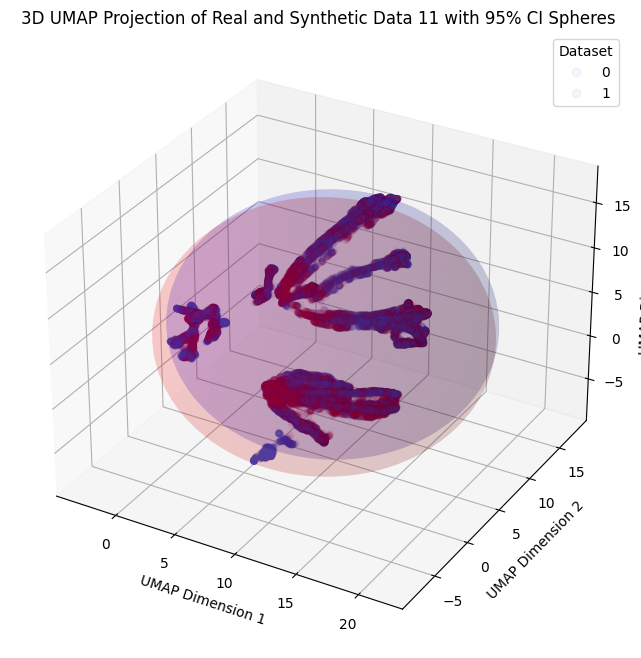

Dataset 11 - Volume of 95% CI for Real Data: 7421.18 cubic units
Dataset 11 - Volume of 95% CI for Synthetic Data: 8120.06 cubic units
Dataset 11 - Distance between centroids: 1.32 units
Dataset 11 - Overlap volume: 7098.26 cubic units
Dataset 11 - Overlap percentage: 84.07%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


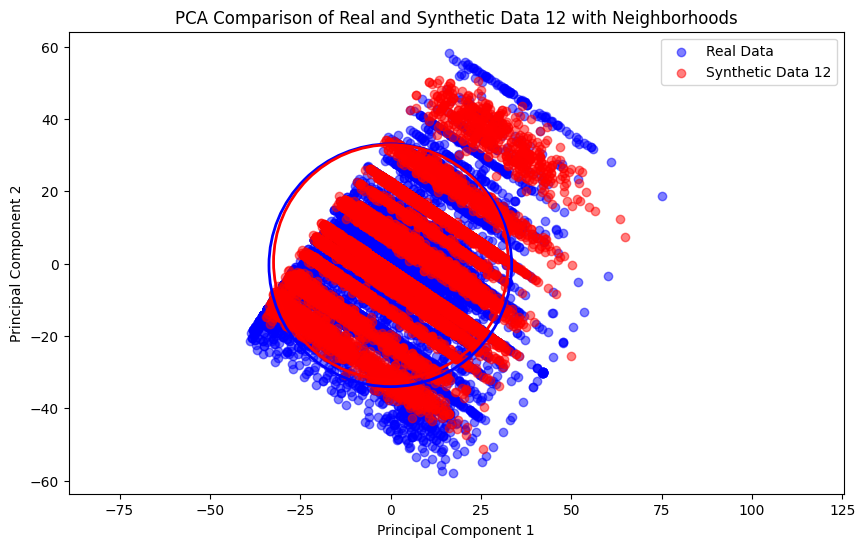

Dataset 12 - Area of 95% CI for Real Data: 3541.08
Dataset 12 - Area of 95% CI for Synthetic Data: 3312.05
Dataset 12 - Distance between centroids: 0.90
Dataset 12 - Overlap area: 3312.05
Dataset 12 - Overlap percentage: 93.53%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


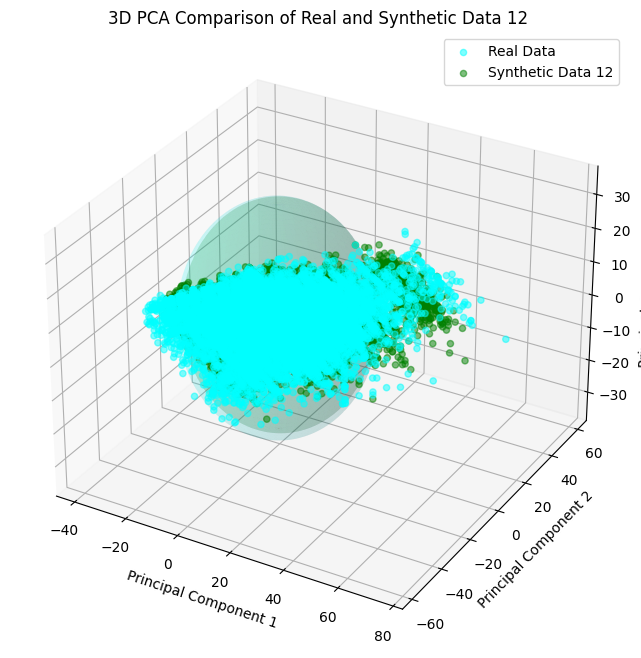

Dataset 12 - Volume of 95% CI for Real Data: 160222.96 cubic units
Dataset 12 - Volume of 95% CI for Synthetic Data: 145006.39 cubic units
Dataset 12 - Distance between centroids: 1.12 units
Dataset 12 - Overlap volume: 145005.33 cubic units
Dataset 12 - Overlap percentage: 90.50%


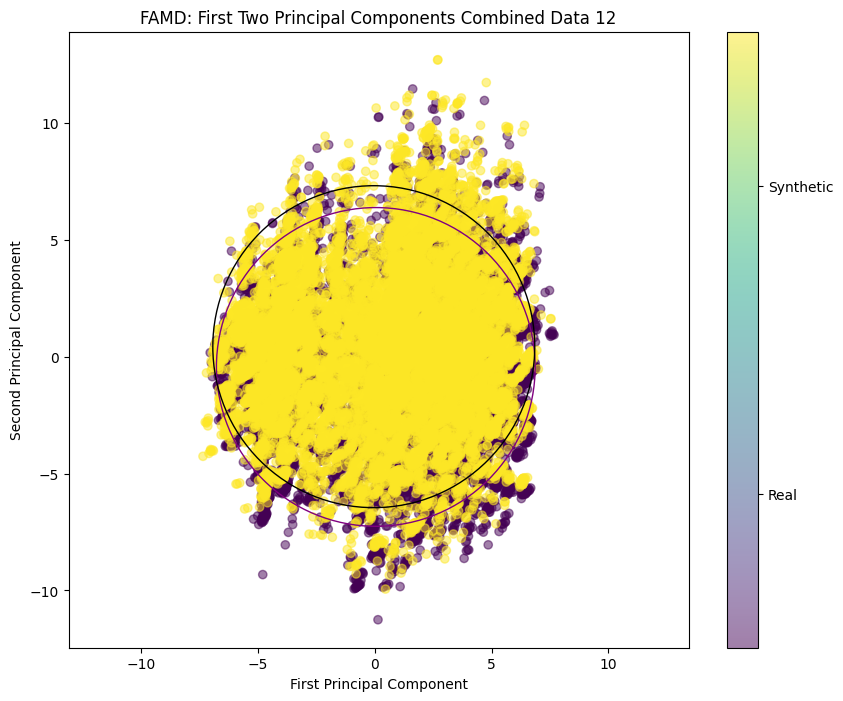

Dataset 12 - Area of 95% CI for Real Data: 146.21
Dataset 12 - Area of 95% CI for Synthetic Data: 149.17
Dataset 12 - Distance between centroids: 0.87
Dataset 12 - Overlap area: 135.71
Dataset 12 - Overlap percentage: 85.00%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


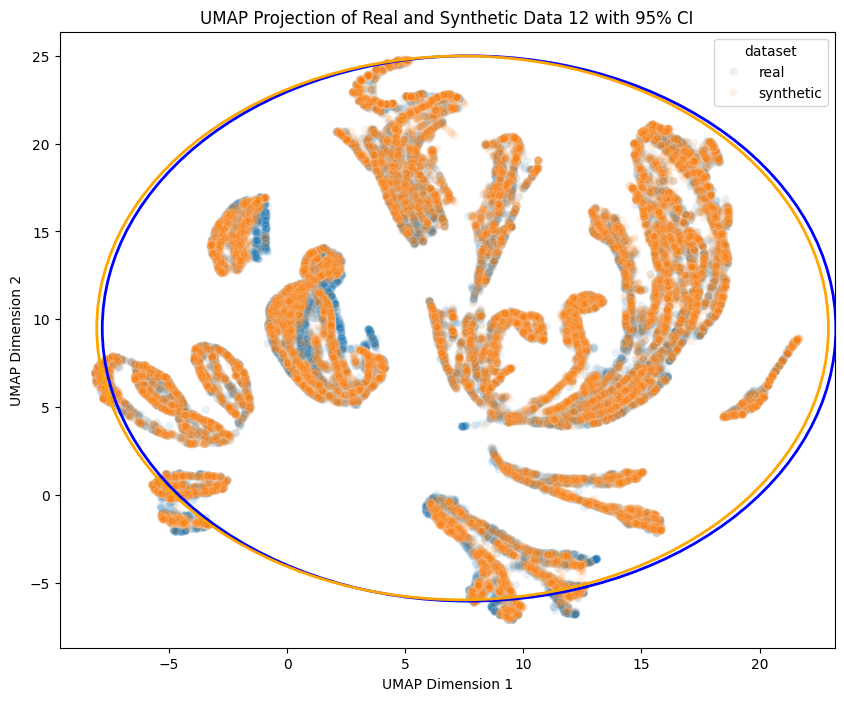

Dataset 12 - Area of 95% CI for Real Data: 757.79
Dataset 12 - Area of 95% CI for Synthetic Data: 753.79
Dataset 12 - Distance between centroids: 0.28
Dataset 12 - Overlap area: 747.13
Dataset 12 - Overlap percentage: 97.73%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


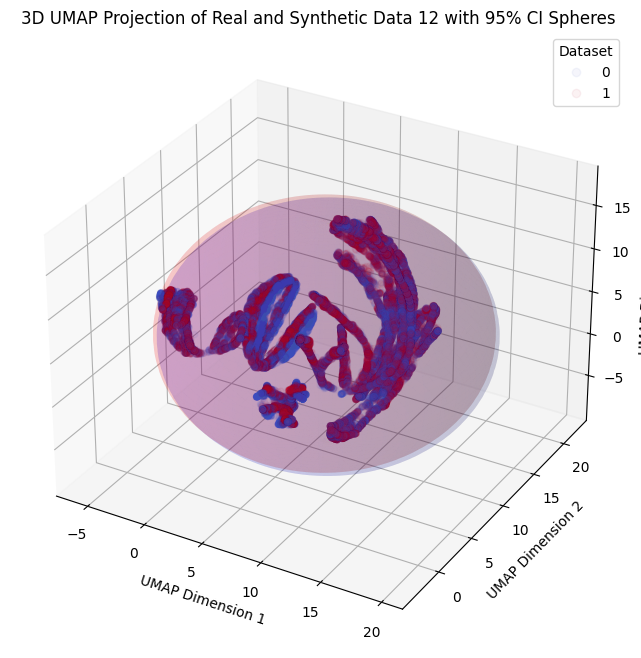

Dataset 12 - Volume of 95% CI for Real Data: 8627.97 cubic units
Dataset 12 - Volume of 95% CI for Synthetic Data: 8617.96 cubic units
Dataset 12 - Distance between centroids: 0.41 units
Dataset 12 - Overlap volume: 8414.42 cubic units
Dataset 12 - Overlap percentage: 95.28%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


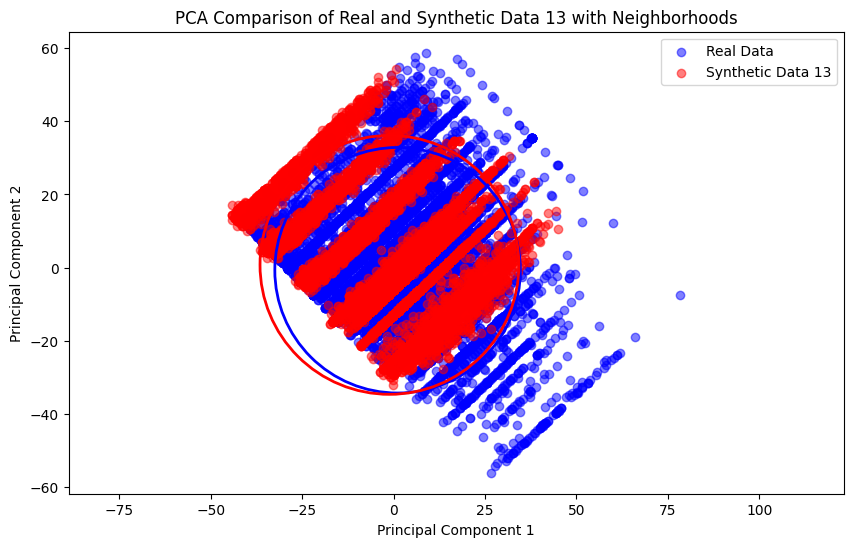

Dataset 13 - Area of 95% CI for Real Data: 3541.51
Dataset 13 - Area of 95% CI for Synthetic Data: 3936.19
Dataset 13 - Distance between centroids: 2.67
Dataset 13 - Overlap area: 3510.12
Dataset 13 - Overlap percentage: 88.47%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


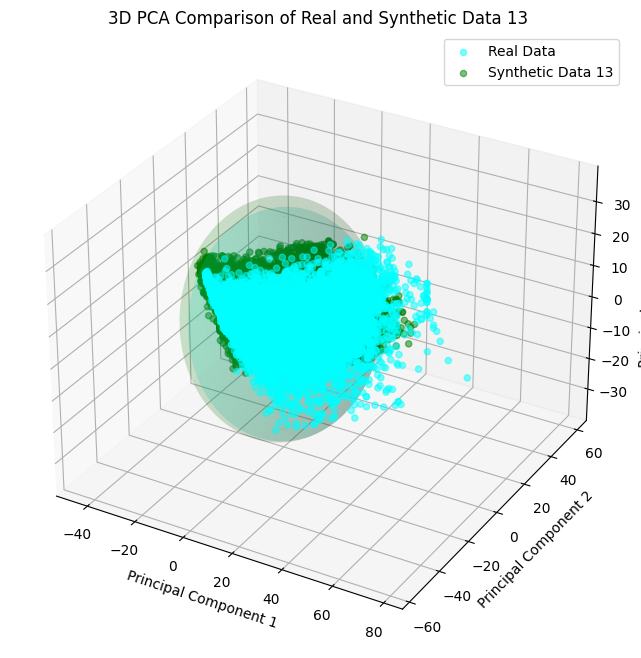

Dataset 13 - Volume of 95% CI for Real Data: 160243.15 cubic units
Dataset 13 - Volume of 95% CI for Synthetic Data: 187913.54 cubic units
Dataset 13 - Distance between centroids: 2.71 units
Dataset 13 - Overlap volume: 159177.19 cubic units
Dataset 13 - Overlap percentage: 84.23%


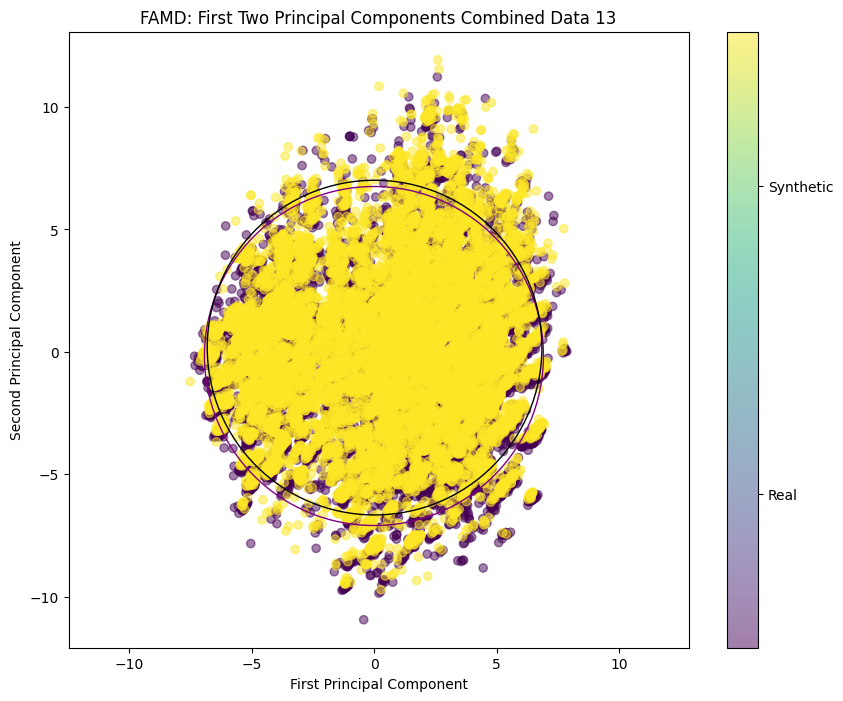

Dataset 13 - Area of 95% CI for Real Data: 150.64
Dataset 13 - Area of 95% CI for Synthetic Data: 146.84
Dataset 13 - Distance between centroids: 0.34
Dataset 13 - Overlap area: 143.84
Dataset 13 - Overlap percentage: 93.62%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


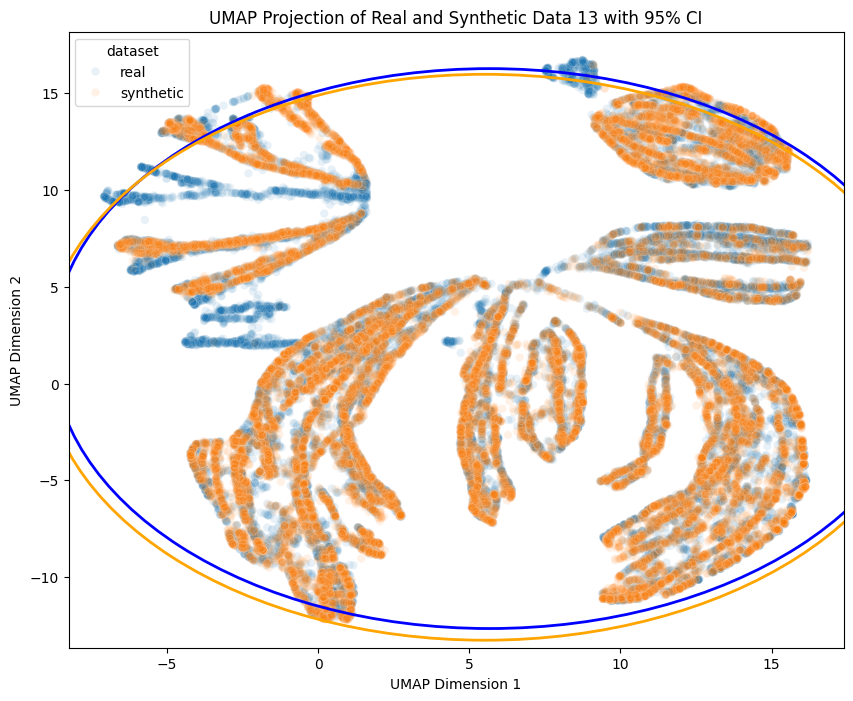

Dataset 13 - Area of 95% CI for Real Data: 657.29
Dataset 13 - Area of 95% CI for Synthetic Data: 671.45
Dataset 13 - Distance between centroids: 0.47
Dataset 13 - Overlap area: 649.89
Dataset 13 - Overlap percentage: 95.73%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


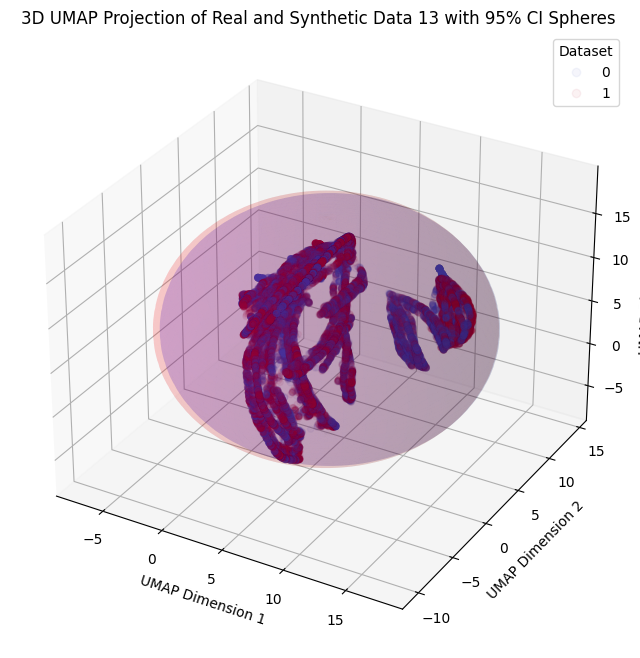

Dataset 13 - Volume of 95% CI for Real Data: 7592.07 cubic units
Dataset 13 - Volume of 95% CI for Synthetic Data: 7986.81 cubic units
Dataset 13 - Distance between centroids: 0.28 units
Dataset 13 - Overlap volume: 7583.25 cubic units
Dataset 13 - Overlap percentage: 94.84%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


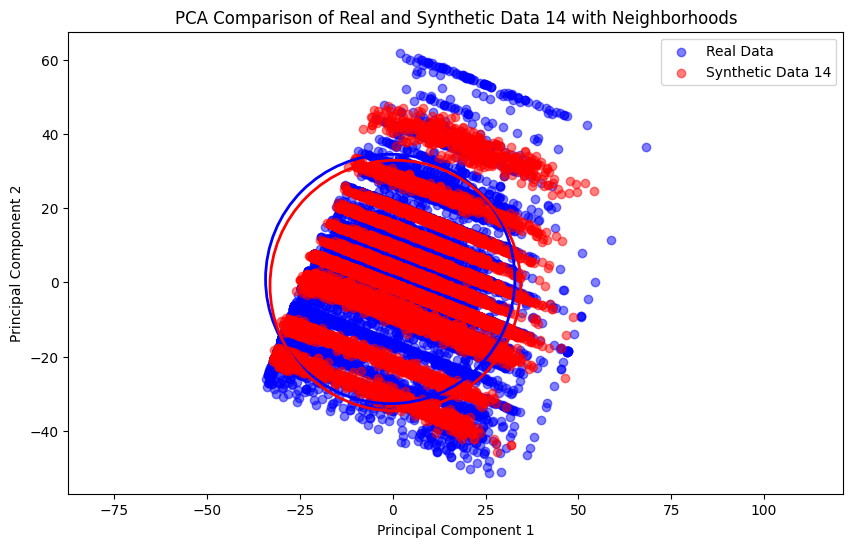

Dataset 14 - Area of 95% CI for Real Data: 3541.73
Dataset 14 - Area of 95% CI for Synthetic Data: 3579.80
Dataset 14 - Distance between centroids: 2.25
Dataset 14 - Overlap area: 3408.58
Dataset 14 - Overlap percentage: 91.80%


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(


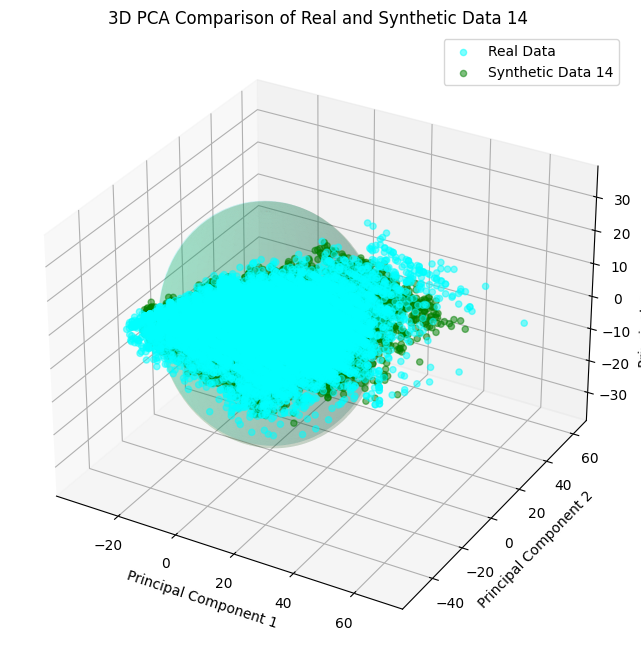

Dataset 14 - Volume of 95% CI for Real Data: 160299.17 cubic units
Dataset 14 - Volume of 95% CI for Synthetic Data: 163247.94 cubic units
Dataset 14 - Distance between centroids: 2.31 units
Dataset 14 - Overlap volume: 153403.23 cubic units
Dataset 14 - Overlap percentage: 90.16%


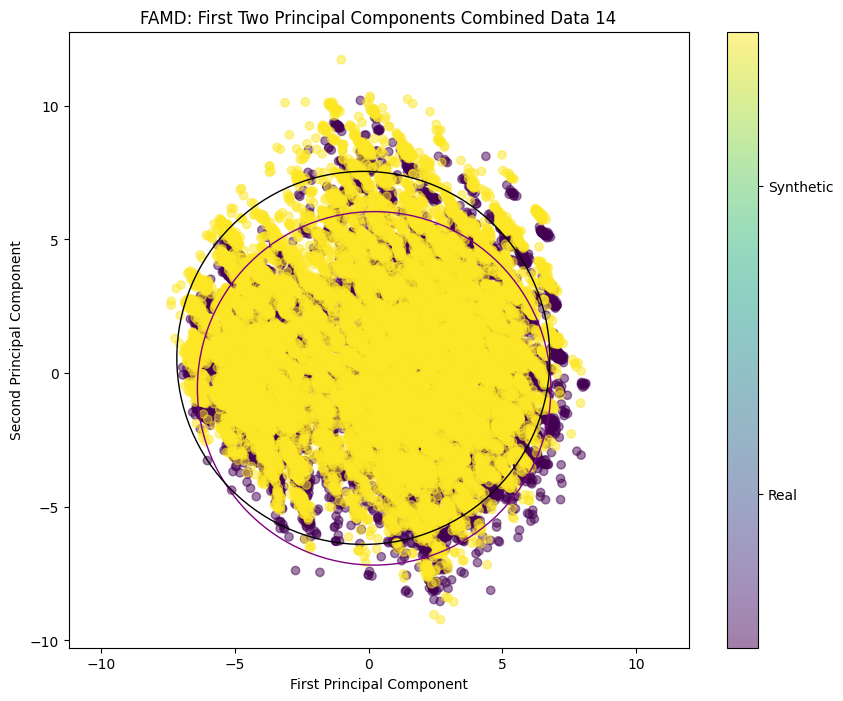

Dataset 14 - Area of 95% CI for Real Data: 137.30
Dataset 14 - Area of 95% CI for Synthetic Data: 152.91
Dataset 14 - Distance between centroids: 1.21
Dataset 14 - Overlap area: 127.95
Dataset 14 - Overlap percentage: 78.86%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


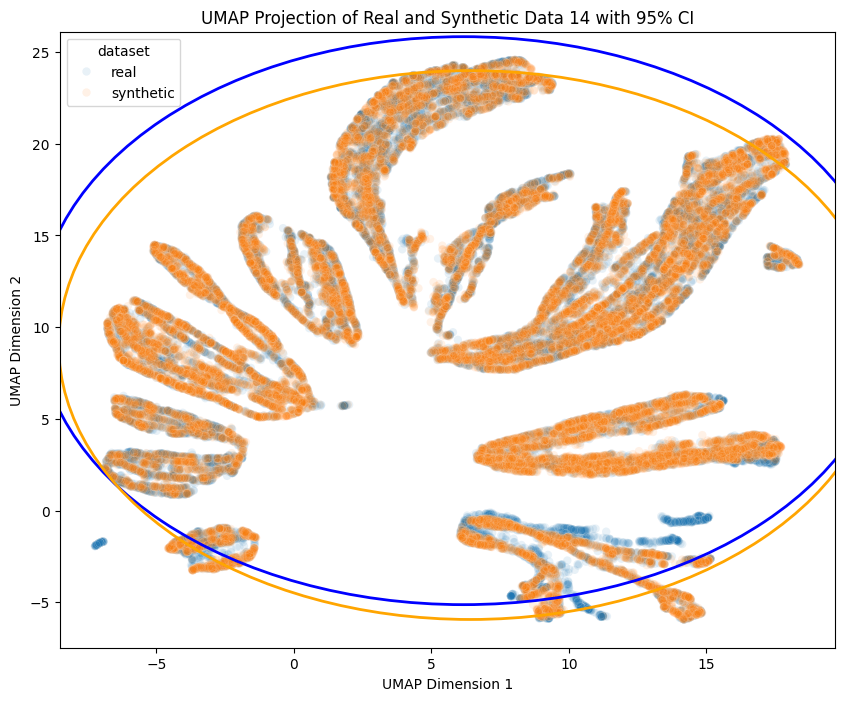

Dataset 14 - Area of 95% CI for Real Data: 753.56
Dataset 14 - Area of 95% CI for Synthetic Data: 703.71
Dataset 14 - Distance between centroids: 1.35
Dataset 14 - Overlap area: 684.34
Dataset 14 - Overlap percentage: 88.54%


/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


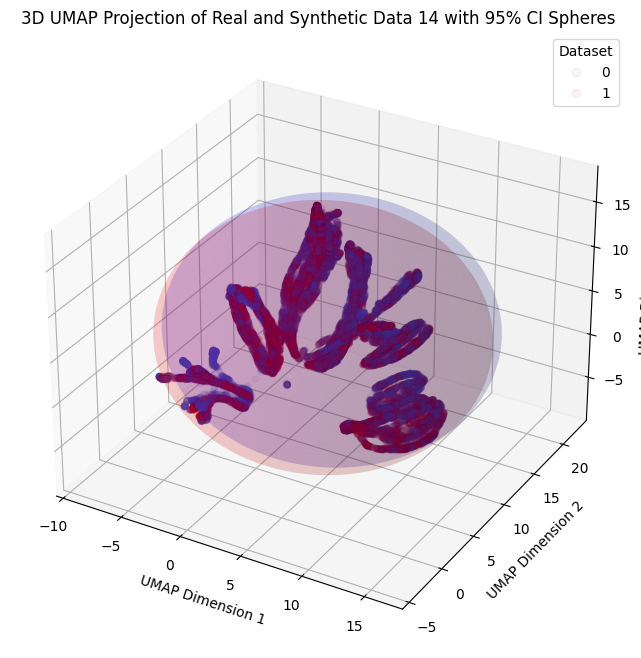

Dataset 14 - Volume of 95% CI for Real Data: 8056.88 cubic units
Dataset 14 - Volume of 95% CI for Synthetic Data: 7974.97 cubic units
Dataset 14 - Distance between centroids: 1.10 units
Dataset 14 - Overlap volume: 7483.42 cubic units
Dataset 14 - Overlap percentage: 87.54%


In [ ]:
# Install necessary packages
!pip install prince umap-learn

# Import required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
import umap.umap_ as umap
from prince import FAMD

# Load the real dataset
real_data = pd.read_csv('real_adults.csv')

# List of synthetic datasets
list_of_synthetic_datasets = [pd.read_csv(f'syn_adults_{i}.csv') for i in range(15)]

# Clean and prepare datasets
def clean_data(data):
    data = data.drop(columns=['Unnamed: 0', 'education'])
    return data

real_data_pca = clean_data(real_data.copy())

categorical_features = [
    'marital-status', 'occupation', 'relationship', 'race', 'sex',
    'native-country', 'employment_type'
]

def encode_data(data, categorical_features):
    return pd.get_dummies(data, columns=categorical_features)

real_data_encoded = encode_data(real_data_pca, categorical_features)

def separate_target(data, target):
    y = data[target]
    X = data.drop(target, axis=1)
    return X, y

X_real, y_real = separate_target(real_data_encoded, 'income')
X_real = X_real.astype(int)

# PCA and visualization functions
def calculate_circle_overlap_area(r1, r2, d):
    """Calculate the area of overlap between two circles given radii and distance between centers."""
    if d >= r1 + r2:
        return 0  # for no overlap
    elif d <= abs(r1 - r2):
        return np.pi * min(r1, r2)**2  # when one circle is within the other
    else:
        part1 = r1**2 * np.arccos((d**2 + r1**2 - r2**2) / (2 * d * r1))
        part2 = r2**2 * np.arccos((d**2 + r2**2 - r1**2) / (2 * d * r2))
        part3 = 0.5 * np.sqrt((-d + r1 + r2) * (d + r1 - r2) * (d - r1 + r2) * (d + r1 + r2))
        return part1 + part2 - part3

def calculate_sphere_intersection_volume(r1, r2, d):
    """Calculate the volume of intersection between two spheres."""
    if d >= r1 + r2:
        return 0  # No overlap
    elif d <= abs(r1 - r2):
        return (4/3) * np.pi * min(r1, r2)**3  # One sphere is completely within the other
    else:
        part1 = (np.pi * (r1 + r2 - d)**2 * (d**2 + 2*d*(r1 + r2) - 3*(r1 - r2)**2)) / (12 * d)
        return part1

def draw_sphere(ax, center, radius, color, alpha=0.1):
    """Utility function to draw a sphere in 3D plot."""
    u = np.linspace(0, 2 * np.pi, 100)
    v = np.linspace(0, np.pi, 100)
    x = center[0] + radius * np.outer(np.cos(u), np.sin(v))
    y = center[1] + radius * np.outer(np.sin(u), np.sin(v))
    z = center[2] + radius * np.outer(np.ones(np.size(u)), np.cos(v))
    ax.plot_surface(x, y, z, color=color, alpha=alpha, linewidth=0)

def perform_pca_and_visualize(X_real, X_syn, index):
    X_real_local = X_real.copy()
    X_syn_local = X_syn.copy()

    for column in X_real.columns:
        if column not in X_syn.columns:
            X_syn_local[column] = 0
    for column in X_syn.columns:
        if column not in X_real.columns:
            X_real_local[column] = 0

    # Perform PCA
    pca = PCA(n_components=2)
    combined_features = np.vstack((X_real_local, X_syn_local))
    pca.fit(combined_features)

    X_real_pca = pca.transform(X_real_local)
    X_syn_pca = pca.transform(X_syn_local)

    # Calculate centroids and radii
    centroid_real = np.mean(X_real_pca, axis=0)
    centroid_syn = np.mean(X_syn_pca, axis=0)

    distances_real = np.sqrt(((X_real_pca - centroid_real) ** 2).sum(axis=1))
    distances_syn = np.sqrt(((X_syn_pca - centroid_syn) ** 2).sum(axis=1))

    radii_real = np.percentile(distances_real, 95)
    radii_syn = np.percentile(distances_syn, 95)

    # Plot PCA results
    plt.figure(figsize=(10, 6))
    plt.scatter(X_real_pca[:, 0], X_real_pca[:, 1], alpha=0.5, label='Real Data', color='blue')
    plt.scatter(X_syn_pca[:, 0], X_syn_pca[:, 1], alpha=0.5, label=f'Synthetic Data {index}', color='red')

    circle_real = plt.Circle(centroid_real, radii_real, color='blue', fill=False, linewidth=2)
    circle_syn = plt.Circle(centroid_syn, radii_syn, color='red', fill=False, linewidth=2)
    plt.gca().add_patch(circle_real)
    plt.gca().add_patch(circle_syn)

    plt.title(f'PCA Comparison of Real and Synthetic Data {index} with Neighborhoods')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.legend()
    plt.axis('equal')
    plt.show()

    # Calculate and print overlap metrics
    distance_between_centroids = np.linalg.norm(centroid_real - centroid_syn)
    overlap_area = calculate_circle_overlap_area(radii_real, radii_syn, distance_between_centroids)
    total_area = np.pi * radii_real**2 + np.pi * radii_syn**2 - overlap_area
    overlap_percentage = (overlap_area / total_area) * 100 if total_area > 0 else 0

    print(f"Dataset {index} - Area of 95% CI for Real Data: {np.pi * radii_real**2:.2f}")
    print(f"Dataset {index} - Area of 95% CI for Synthetic Data: {np.pi * radii_syn**2:.2f}")
    print(f"Dataset {index} - Distance between centroids: {distance_between_centroids:.2f}")
    print(f"Dataset {index} - Overlap area: {overlap_area:.2f}")
    print(f"Dataset {index} - Overlap percentage: {overlap_percentage:.2f}%")

def perform_3d_pca_and_visualize(X_real, X_syn, index):
    X_real_local = X_real.copy()
    X_syn_local = X_syn.copy()

    for column in X_real.columns:
        if column not in X_syn.columns:
            X_syn_local[column] = 0
    for column in X_syn.columns:
        if column not in X_real.columns:
            X_real_local[column] = 0

    X_real_local = X_real_local.reindex(sorted(X_real_local.columns), axis=1)
    X_syn_local = X_syn_local.reindex(sorted(X_syn_local.columns), axis=1)

    pca = PCA(n_components=3)
    combined_features = np.vstack((X_real_local, X_syn_local))
    pca.fit(combined_features)

    X_real_pca = pca.transform(X_real_local)
    X_syn_pca = pca.transform(X_syn_local)

    centroid_real = np.mean(X_real_pca, axis=0)
    centroid_syn = np.mean(X_syn_pca, axis=0)

    distances_real = np.sqrt(((X_real_pca - centroid_real) ** 2).sum(axis=1))
    distances_syn = np.sqrt(((X_syn_pca - centroid_syn) ** 2).sum(axis=1))

    radius_real = np.percentile(distances_real, 95)
    radius_syn = np.percentile(distances_syn, 95)

    volume_real = (4/3) * np.pi * (radius_real ** 3)
    volume_syn = (4/3) * np.pi * (radius_syn ** 3)

    distance_between_centroids = np.linalg.norm(centroid_real - centroid_syn)
    overlap_volume = calculate_sphere_intersection_volume(radius_real, radius_syn, distance_between_centroids)
    total_volume = volume_real + volume_syn - overlap_volume
    overlap_percentage = (overlap_volume / total_volume) * 100 if total_volume > 0 else 0

    fig = plt.figure(figsize=(12, 8))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(X_real_pca[:, 0], X_real_pca[:, 1], X_real_pca[:, 2], alpha=0.5, label='Real Data', color='cyan')
    ax.scatter(X_syn_pca[:, 0], X_syn_pca[:, 1], X_syn_pca[:, 2], alpha=0.5, label=f'Synthetic Data {index}', color='green')
    draw_sphere(ax, centroid_real, radius_real, 'cyan')
    draw_sphere(ax, centroid_syn, radius_syn, 'green')

    ax.set_xlabel('Principal Component 1')
    ax.set_ylabel('Principal Component 2')
    ax.set_zlabel('Principal Component 3')
    ax.set_title(f'3D PCA Comparison of Real and Synthetic Data {index}')
    ax.legend()

    plt.show()

    print(f"Dataset {index} - Volume of 95% CI for Real Data: {volume_real:.2f} cubic units")
    print(f"Dataset {index} - Volume of 95% CI for Synthetic Data: {volume_syn:.2f} cubic units")
    print(f"Dataset {index} - Distance between centroids: {distance_between_centroids:.2f} units")
    print(f"Dataset {index} - Overlap volume: {overlap_volume:.2f} cubic units")
    print(f"Dataset {index} - Overlap percentage: {overlap_percentage:.2f}%")

def perform_famd_and_visualize(real_data_famd, syn_data_famd, index):
    columns_to_convert = [2, 3, 4, 5, 6, 10, 11, 12]
    real_data_famd.iloc[:, columns_to_convert] = real_data_famd.iloc[:, columns_to_convert].apply(pd.Categorical)
    syn_data_famd.iloc[:, columns_to_convert] = syn_data_famd.iloc[:, columns_to_convert].apply(pd.Categorical)

    real_data_famd['Dataset'] = 'Real'
    syn_data_famd['Dataset'] = 'Synthetic'

    combined_data_famd = pd.concat([real_data_famd, syn_data_famd])

    categorical_columns = ['marital-status', 'occupation', 'relationship', 'race', 'sex', 'native-country', 'employment_type', 'Dataset']
    numerical_columns = ['age', 'education-num', 'hours-per-week']

    for column in categorical_columns:
        combined_data_famd[column] = combined_data_famd[column].astype('category')
    for column in numerical_columns:
        combined_data_famd[column] = combined_data_famd[column].astype(float)

    X_combined_famd = combined_data_famd.drop(columns=['income'])

    famd = FAMD(n_components=2, n_iter=3, random_state=42)
    famd.fit(X_combined_famd)
    X_transformed_famd = famd.transform(X_combined_famd)

    real_transformed_famd = X_transformed_famd[combined_data_famd['Dataset'] == 'Real']
    synthetic_transformed_famd = X_transformed_famd[combined_data_famd['Dataset'] == 'Synthetic']

    centroid_real_famd = np.mean(real_transformed_famd, axis=0)
    centroid_synthetic_famd = np.mean(synthetic_transformed_famd, axis=0)

    distances_real_famd = np.sqrt(((real_transformed_famd - centroid_real_famd) ** 2).sum(axis=1))
    distances_synthetic_famd = np.sqrt(((synthetic_transformed_famd - centroid_synthetic_famd) ** 2).sum(axis=1))

    radius_real_famd = np.percentile(distances_real_famd, 95)
    radius_synthetic_famd = np.percentile(distances_synthetic_famd, 95)

    area_real_famd = np.pi * (radius_real_famd ** 2)
    area_synthetic_famd = np.pi * (radius_synthetic_famd ** 2)

    distance_between_centroids_famd = np.linalg.norm(centroid_real_famd - centroid_synthetic_famd)

    overlap_area_famd = calculate_circle_overlap_area(radius_real_famd, radius_synthetic_famd, distance_between_centroids_famd)
    total_area_famd = (np.pi * radius_real_famd**2) + (np.pi * radius_synthetic_famd**2) - overlap_area_famd
    overlap_percentage_famd = (overlap_area_famd / total_area_famd) * 100 if total_area_famd > 0 else 0

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(X_transformed_famd.iloc[:, 0], X_transformed_famd.iloc[:, 1], c=combined_data_famd['Dataset'].cat.codes, cmap='viridis', alpha=0.5)
    circle_real_famd = plt.Circle(centroid_real_famd, radius_real_famd, color='purple', fill=False)
    circle_synthetic_famd = plt.Circle(centroid_synthetic_famd, radius_synthetic_famd, color='black', fill=False)
    plt.gca().add_patch(circle_real_famd)
    plt.gca().add_patch(circle_synthetic_famd)

    plt.title(f'FAMD: First Two Principal Components Combined Data {index}')
    plt.xlabel('First Principal Component')
    plt.ylabel('Second Principal Component')
    colorbar = plt.colorbar(scatter)
    colorbar.set_ticks([0.25, 0.75])
    colorbar.set_ticklabels(['Real', 'Synthetic'])
    plt.axis('equal')
    plt.show()

    print(f"Dataset {index} - Area of 95% CI for Real Data: {area_real_famd:.2f}")
    print(f"Dataset {index} - Area of 95% CI for Synthetic Data: {area_synthetic_famd:.2f}")
    print(f"Dataset {index} - Distance between centroids: {distance_between_centroids_famd:.2f}")
    print(f"Dataset {index} - Overlap area: {overlap_area_famd:.2f}")
    print(f"Dataset {index} - Overlap percentage: {overlap_percentage_famd:.2f}%")

def umap_visualization(real_data, syn_data, index, n_components=2):
    real_data_umap = clean_data(real_data.copy())
    syn_data_umap = clean_data(syn_data.copy())

    real_data_umap['Dataset'] = 'Real'
    syn_data_umap['Dataset'] = 'Synthetic'

    combined_data_umap = pd.concat([real_data_umap, syn_data_umap])

    categorical_columns = ['marital-status', 'occupation', 'relationship', 'race', 'sex', 'native-country', 'employment_type', 'Dataset']
    numerical_columns = ['age', 'education-num', 'hours-per-week']

    for column in categorical_columns:
        combined_data_umap[column] = combined_data_umap[column].astype('category')
    for column in numerical_columns:
        combined_data_umap[column] = combined_data_umap[column].astype(float)

    X_combined_umap = combined_data_umap.drop(columns=['income'])

    combined_data_umap = pd.concat([
        real_data_umap.assign(dataset='real'),
        syn_data_umap.assign(dataset='synthetic')
    ])

    numeric_data = combined_data_umap.select_dtypes(include=[np.number])

    reducer = umap.UMAP(n_components=n_components, random_state=42)
    embedding = reducer.fit_transform(numeric_data)
    embedding_df = pd.DataFrame(embedding, columns=[f'UMAP_{i+1}' for i in range(n_components)])
    embedding_df['dataset'] = combined_data_umap['dataset'].values

    real_data_umap = embedding_df[embedding_df['dataset'] == 'real']
    synthetic_data_umap = embedding_df[embedding_df['dataset'] == 'synthetic']
    centroid_real = np.mean(real_data_umap.iloc[:, :n_components], axis=0)
    centroid_synthetic = np.mean(synthetic_data_umap.iloc[:, :n_components], axis=0)

    distances_real = np.linalg.norm(real_data_umap.iloc[:, :n_components] - centroid_real, axis=1)
    distances_synthetic = np.linalg.norm(synthetic_data_umap.iloc[:, :n_components] - centroid_synthetic, axis=1)
    radius_real = np.percentile(distances_real, 95)
    radius_synthetic = np.percentile(distances_synthetic, 95)

    if n_components == 2:
        area_real = np.pi * (radius_real ** 2)
        area_synthetic = np.pi * (radius_synthetic ** 2)
        distance_between_centroids = np.linalg.norm(centroid_real - centroid_synthetic)
        overlap_area = calculate_circle_overlap_area(radius_real, radius_synthetic, distance_between_centroids)
        total_area = area_real + area_synthetic - overlap_area
        overlap_percentage = (overlap_area / total_area) * 100 if total_area > 0 else 0

        plt.figure(figsize=(10, 8))
        sns.scatterplot(data=embedding_df, x='UMAP_1', y='UMAP_2', hue='dataset', alpha=0.1)

        circle_real = plt.Circle(centroid_real, radius_real, color='blue', fill=False, lw=2)
        circle_synthetic = plt.Circle(centroid_synthetic, radius_synthetic, color='orange', fill=False, lw=2)
        plt.gca().add_patch(circle_real)
        plt.gca().add_patch(circle_synthetic)

        plt.title(f'UMAP Projection of Real and Synthetic Data {index} with 95% CI')
        plt.xlabel('UMAP Dimension 1')
        plt.ylabel('UMAP Dimension 2')
        plt.show()

        print(f"Dataset {index} - Area of 95% CI for Real Data: {area_real:.2f}")
        print(f"Dataset {index} - Area of 95% CI for Synthetic Data: {area_synthetic:.2f}")
        print(f"Dataset {index} - Distance between centroids: {distance_between_centroids:.2f}")
        print(f"Dataset {index} - Overlap area: {overlap_area:.2f}")
        print(f"Dataset {index} - Overlap percentage: {overlap_percentage:.2f}%")

    elif n_components == 3:
        volume_real = (4/3) * np.pi * (radius_real ** 3)
        volume_syn = (4/3) * np.pi * (radius_synthetic ** 3)
        distance_between_centroids = np.linalg.norm(centroid_real - centroid_synthetic)
        overlap_volume = calculate_sphere_intersection_volume(radius_real, radius_synthetic, distance_between_centroids)
        overlap_percentage = (overlap_volume / (volume_real + volume_syn - overlap_volume)) * 100 if (volume_real + volume_syn - overlap_volume) > 0 else 0

        fig = plt.figure(figsize=(10, 8))
        ax = fig.add_subplot(111, projection='3d')
        scatter = ax.scatter(embedding_df['UMAP_1'], embedding_df['UMAP_2'], embedding_df['UMAP_3'],
                            c=np.where(embedding_df['dataset'] == 'real', 0, 1),
                            cmap='coolwarm', alpha=0.05)

        draw_sphere(ax, centroid_real, radius_real, 'blue')
        draw_sphere(ax, centroid_synthetic, radius_synthetic, 'red')

        ax.set_xlabel('UMAP Dimension 1')
        ax.set_ylabel('UMAP Dimension 2')
        ax.set_zlabel('UMAP Dimension 3')
        ax.set_title(f'3D UMAP Projection of Real and Synthetic Data {index} with 95% CI Spheres')
        ax.legend(*scatter.legend_elements(), title="Dataset")
        plt.show()

        print(f"Dataset {index} - Volume of 95% CI for Real Data: {volume_real:.2f} cubic units")
        print(f"Dataset {index} - Volume of 95% CI for Synthetic Data: {volume_syn:.2f} cubic units")
        print(f"Dataset {index} - Distance between centroids: {distance_between_centroids:.2f} units")
        print(f"Dataset {index} - Overlap volume: {overlap_volume:.2f} cubic units")
        print(f"Dataset {index} - Overlap percentage: {overlap_percentage:.2f}%")

# Process each synthetic dataset
for index, syn_data in enumerate(list_of_synthetic_datasets):
    syn_data_pca = clean_data(syn_data.copy())
    syn_data_encoded = encode_data(syn_data_pca, categorical_features)
    X_syn, y_syn = separate_target(syn_data_encoded, 'income')
    X_syn = X_syn.astype(int)

    # Run PCA and visualization for each synthetic dataset
    perform_pca_and_visualize(X_real, X_syn, index)
    perform_3d_pca_and_visualize(X_real, X_syn, index)

    # FAMD and visualization
    real_data_famd = clean_data(real_data.copy())
    syn_data_famd = clean_data(syn_data.copy())
    perform_famd_and_visualize(real_data_famd, syn_data_famd, index)

    # UMAP visualizations
    umap_visualization(real_data, syn_data, index, n_components=2)
    umap_visualization(real_data, syn_data, index, n_components=3)

This code below simply tabulates all the results from above and saves them into a csv file named "analysis_results.csv

In [ ]:
# Install necessary packages
!pip install prince umap-learn

import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from prince import FAMD
import umap.umap_ as umap

# Define your data cleaning and processing functions
def clean_data(data):
    data = data.drop(columns=['Unnamed: 0', 'education'])
    return data

def encode_data(data, categorical_features):
    return pd.get_dummies(data, columns=categorical_features)

def separate_target(data, target):
    y = data[target]
    X = data.drop(target, axis=1)
    return X, y

def circle_overlap_area(r1, r2, d):
    if d >= r1 + r2:
        return 0
    elif d <= abs(r1 - r2):
        return np.pi * min(r1, r2)**2
    else:
        part1 = r1**2 * np.arccos((d**2 + r1**2 - r2**2) / (2 * d * r1))
        part2 = r2**2 * np.arccos((d**2 + r2**2 - r1**2) / (2 * d * r2))
        part3 = 0.5 * np.sqrt((-d + r1 + r2) * (d + r1 - r2) * (d - r1 + r2) * (d + r1 + r2))
        return part1 + part2 - part3

def calculate_sphere_intersection_volume(r1, r2, d):
    if d >= r1 + r2:
        return 0
    elif d <= abs(r1 - r2):
        return 4/3 * np.pi * min(r1, r2)**3
    else:
        part1 = (r1**2) * np.arccos((d**2 + r1**2 - r2**2) / (2 * d * r1))
        part2 = (r2**2) * np.arccos((d**2 + r2**2 - r1**2) / (2 * d * r2))
        part3 = 0.5 * np.sqrt((-d + r1 + r2) * (d + r1 - r2) * (d - r1 + r2) * (d + r1 + r2))
        return part1 + part2 - part3

# Load the real dataset
real_data = pd.read_csv('real_adults.csv')

# List of synthetic datasets
list_of_synthetic_datasets = [pd.read_csv(f'syn_adults_{i}.csv') for i in range(15)]

# Clean and prepare datasets
real_data_pca = clean_data(real_data.copy())
categorical_features = ['marital-status', 'occupation', 'relationship', 'race', 'sex', 'native-country', 'employment_type']
real_data_encoded = encode_data(real_data_pca, categorical_features)
X_real, y_real = separate_target(real_data_encoded, 'income')
X_real = X_real.astype(int)

results = []

def perform_pca_and_collect_results(X_real, X_syn, index):
    X_real_local = X_real.copy()
    X_syn_local = X_syn.copy()

    for column in X_real.columns:
        if column not in X_syn.columns:
            X_syn_local[column] = 0
    for column in X_syn.columns:
        if column not in X_real.columns:
            X_real_local[column] = 0

    pca = PCA(n_components=2)
    combined_features = np.vstack((X_real_local, X_syn_local))
    pca.fit(combined_features)

    X_real_pca = pca.transform(X_real_local)
    X_syn_pca = pca.transform(X_syn_local)

    centroid_real = np.mean(X_real_pca, axis=0)
    centroid_syn = np.mean(X_syn_pca, axis=0)

    distances_real = np.sqrt(((X_real_pca - centroid_real) ** 2).sum(axis=1))
    distances_syn = np.sqrt(((X_syn_pca - centroid_syn) ** 2).sum(axis=1))

    radii_real = np.percentile(distances_real, 95)
    radii_syn = np.percentile(distances_syn, 95)

    distance_between_centroids = np.linalg.norm(centroid_real - centroid_syn)
    overlap_area = circle_overlap_area(radii_real, radii_syn, distance_between_centroids)
    total_area = np.pi * radii_real**2 + np.pi * radii_syn**2 - overlap_area
    overlap_percentage = (overlap_area / total_area) * 100 if total_area > 0 else 0

    results.append({
        'Method': '2D PCA',
        'Dataset': index,
        'Confidence Interval Volume Real': np.pi * radii_real**2,
        'Confidence Interval Volume Synthetic': np.pi * radii_syn**2,
        'Distance between Centroids': distance_between_centroids,
        'Overlap Volume': overlap_area,
        'Overlap Percent': overlap_percentage
    })

def perform_3d_pca_and_collect_results(X_real, X_syn, index):
    X_real_local = X_real.copy()
    X_syn_local = X_syn.copy()

    for column in X_real.columns:
        if column not in X_syn.columns:
            X_syn_local[column] = 0
    for column in X_syn.columns:
        if column not in X_real.columns:
            X_real_local[column] = 0

    X_real_local = X_real_local.reindex(sorted(X_real_local.columns), axis=1)
    X_syn_local = X_syn_local.reindex(sorted(X_syn_local.columns), axis=1)

    pca = PCA(n_components=3)
    combined_features = np.vstack((X_real_local, X_syn_local))
    pca.fit(combined_features)

    X_real_pca = pca.transform(X_real_local)
    X_syn_pca = pca.transform(X_syn_local)

    centroid_real = np.mean(X_real_pca, axis=0)
    centroid_syn = np.mean(X_syn_pca, axis=0)

    distances_real = np.sqrt(((X_real_pca - centroid_real) ** 2).sum(axis=1))
    distances_syn = np.sqrt(((X_syn_pca - centroid_syn) ** 2).sum(axis=1))

    radius_real = np.percentile(distances_real, 95)
    radius_syn = np.percentile(distances_syn, 95)

    volume_real = (4/3) * np.pi * (radius_real ** 3)
    volume_syn = (4/3) * np.pi * (radius_syn ** 3)

    distance_between_centroids = np.linalg.norm(centroid_real - centroid_syn)
    overlap_volume = calculate_sphere_intersection_volume(radius_real, radius_syn, distance_between_centroids)
    overlap_percentage = (overlap_volume / (volume_real + volume_syn - overlap_volume)) * 100 if (volume_real + volume_syn - overlap_volume) > 0 else 0

    results.append({
        'Method': '3D PCA',
        'Dataset': index,
        'Confidence Interval Volume Real': volume_real,
        'Confidence Interval Volume Synthetic': volume_syn,
        'Distance between Centroids': distance_between_centroids,
        'Overlap Volume': overlap_volume,
        'Overlap Percent': overlap_percentage
    })

def perform_famd_and_collect_results(real_data_famd, syn_data_famd, index):
    columns_to_convert = [2, 3, 4, 5, 6, 10, 11, 12]
    real_data_famd.iloc[:, columns_to_convert] = real_data_famd.iloc[:, columns_to_convert].apply(pd.Categorical)
    syn_data_famd.iloc[:, columns_to_convert] = syn_data_famd.iloc[:, columns_to_convert].apply(pd.Categorical)

    real_data_famd['Dataset'] = 'Real'
    syn_data_famd['Dataset'] = 'Synthetic'

    combined_data_famd = pd.concat([real_data_famd, syn_data_famd])

    categorical_columns = ['marital-status', 'occupation', 'relationship', 'race', 'sex', 'native-country', 'employment_type', 'Dataset']
    numerical_columns = ['age', 'education-num', 'hours-per-week']

    for column in categorical_columns:
        combined_data_famd[column] = combined_data_famd[column].astype('category')
    for column in numerical_columns:
        combined_data_famd[column] = combined_data_famd[column].astype(float)

    X_combined_famd = combined_data_famd.drop(columns=['income'])

    famd = FAMD(n_components=2, n_iter=3, random_state=42)
    famd.fit(X_combined_famd)
    X_transformed_famd = famd.transform(X_combined_famd)

    real_transformed_famd = X_transformed_famd[combined_data_famd['Dataset'] == 'Real']
    synthetic_transformed_famd = X_transformed_famd[combined_data_famd['Dataset'] == 'Synthetic']

    centroid_real_famd = np.mean(real_transformed_famd, axis=0)
    centroid_synthetic_famd = np.mean(synthetic_transformed_famd, axis=0)

    distances_real_famd = np.sqrt(((real_transformed_famd - centroid_real_famd) ** 2).sum(axis=1))
    distances_synthetic_famd = np.sqrt(((synthetic_transformed_famd - centroid_synthetic_famd) ** 2).sum(axis=1))

    radius_real_famd = np.percentile(distances_real_famd, 95)
    radius_synthetic_famd = np.percentile(distances_synthetic_famd, 95)

    area_real_famd = np.pi * (radius_real_famd ** 2)
    area_synthetic_famd = np.pi * (radius_synthetic_famd ** 2)

    distance_between_centroids_famd = np.linalg.norm(centroid_real_famd - centroid_synthetic_famd)
    overlap_area_famd = circle_overlap_area(radius_real_famd, radius_synthetic_famd, distance_between_centroids_famd)
    total_area_famd = (np.pi * radius_real_famd**2) + (np.pi * radius_synthetic_famd**2) - overlap_area_famd
    overlap_percentage_famd = (overlap_area_famd / total_area_famd) * 100 if total_area_famd > 0 else 0

    results.append({
        'Method': 'FAMD',
        'Dataset': index,
        'Confidence Interval Volume Real': area_real_famd,
        'Confidence Interval Volume Synthetic': area_synthetic_famd,
        'Distance between Centroids': distance_between_centroids_famd,
        'Overlap Volume': overlap_area_famd,
        'Overlap Percent': overlap_percentage_famd
    })

def umap_visualization_and_collect_results(real_data, syn_data, index, n_components=2):
    real_data_umap = clean_data(real_data.copy())
    syn_data_umap = clean_data(syn_data.copy())

    real_data_umap['Dataset'] = 'Real'
    syn_data_umap['Dataset'] = 'Synthetic'

    combined_data_umap = pd.concat([real_data_umap, syn_data_umap])

    categorical_columns = ['marital-status', 'occupation', 'relationship', 'race', 'sex', 'native-country', 'employment_type', 'Dataset']
    numerical_columns = ['age', 'education-num', 'hours-per-week']

    for column in categorical_columns:
        combined_data_umap[column] = combined_data_umap[column].astype('category')
    for column in numerical_columns:
        combined_data_umap[column] = combined_data_umap[column].astype(float)

    X_combined_umap = combined_data_umap.drop(columns=['income'])

    combined_data_umap = pd.concat([
        real_data_umap.assign(dataset='real'),
        syn_data_umap.assign(dataset='synthetic')
    ])

    numeric_data = combined_data_umap.select_dtypes(include=[np.number])

    reducer = umap.UMAP(n_components=n_components, random_state=42)
    embedding = reducer.fit_transform(numeric_data)
    embedding_df = pd.DataFrame(embedding, columns=[f'UMAP_{i+1}' for i in range(n_components)])
    embedding_df['dataset'] = combined_data_umap['dataset'].values

    real_data_umap = embedding_df[embedding_df['dataset'] == 'real']
    synthetic_data_umap = embedding_df[embedding_df['dataset'] == 'synthetic']
    centroid_real = np.mean(real_data_umap.iloc[:, :n_components], axis=0)
    centroid_synthetic = np.mean(synthetic_data_umap.iloc[:, :n_components], axis=0)

    distances_real = np.linalg.norm(real_data_umap.iloc[:, :n_components] - centroid_real, axis=1)
    distances_synthetic = np.linalg.norm(synthetic_data_umap.iloc[:, :n_components] - centroid_synthetic, axis=1)
    radius_real = np.percentile(distances_real, 95)
    radius_synthetic = np.percentile(distances_synthetic, 95)

    if n_components == 2:
        area_real = np.pi * (radius_real ** 2)
        area_synthetic = np.pi * (radius_synthetic ** 2)
        distance_between_centroids = np.linalg.norm(centroid_real - centroid_synthetic)
        overlap_area = circle_overlap_area(radius_real, radius_synthetic, distance_between_centroids)
        total_area = area_real + area_synthetic - overlap_area
        overlap_percentage = (overlap_area / total_area) * 100 if total_area > 0 else 0

        results.append({
            'Method': '2D UMAP',
            'Dataset': index,
            'Confidence Interval Volume Real': area_real,
            'Confidence Interval Volume Synthetic': area_synthetic,
            'Distance between Centroids': distance_between_centroids,
            'Overlap Volume': overlap_area,
            'Overlap Percent': overlap_percentage
        })

    elif n_components == 3:
        volume_real = (4/3) * np.pi * (radius_real ** 3)
        volume_syn = (4/3) * np.pi * (radius_synthetic ** 3)
        distance_between_centroids = np.linalg.norm(centroid_real - centroid_synthetic)
        overlap_volume = calculate_sphere_intersection_volume(radius_real, radius_synthetic, distance_between_centroids)
        overlap_percentage = (overlap_volume / (volume_real + volume_syn - overlap_volume)) * 100 if (volume_real + volume_syn - overlap_volume) > 0 else 0

        results.append({
            'Method': '3D UMAP',
            'Dataset': index,
            'Confidence Interval Volume Real': volume_real,
            'Confidence Interval Volume Synthetic': volume_syn,
            'Distance between Centroids': distance_between_centroids,
            'Overlap Volume': overlap_volume,
            'Overlap Percent': overlap_percentage
        })

# Process each synthetic dataset
for index, syn_data in enumerate(list_of_synthetic_datasets):
    syn_data_pca = clean_data(syn_data.copy())
    syn_data_encoded = encode_data(syn_data_pca, categorical_features)
    X_syn, y_syn = separate_target(syn_data_encoded, 'income')
    X_syn = X_syn.astype(int)

    # Run PCA and visualization for each synthetic dataset
    perform_pca_and_collect_results(X_real, X_syn, index)
    perform_3d_pca_and_collect_results(X_real, X_syn, index)

    # FAMD and visualization
    real_data_famd = clean_data(real_data.copy())
    syn_data_famd = clean_data(syn_data.copy())
    perform_famd_and_collect_results(real_data_famd, syn_data_famd, index)

    # UMAP visualizations
    umap_visualization_and_collect_results(real_data, syn_data, index, n_components=2)
    umap_visualization_and_collect_results(real_data, syn_data, index, n_components=3)

# Create a DataFrame from the results and save to a CSV file
results_df = pd.DataFrame(results)
results_df.to_csv('analysis_results.csv', index=False)

print("Analysis results have been saved to 'analysis_results.csv'.")


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but PCA was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")
/usr/local/lib/python3.10/dist-packages/umap/umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_

Analysis results have been saved to 'analysis_results.csv'.
